In [42]:
import sys

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

import scanpy as sc
import scvi
import collections

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

from datetime import date
today = str(date.today())

import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

# %cd /nfs/team205/vk8/processed_data/muscle/data_v3

results = './write/'

In [2]:
general_mrkrs = [ 'MYH7', 'TNNT1', 'TNNT3', 'MYH1', 'MYH2', "CKM", "MB", # Myofibers
           'PAX7', 'DLK1', # MuSCs
           'PDGFRA', 'DCN', 'ANGPTL7', 'OSR2', 'NGFR', 'SLC22A3','ITGA6', # Fibroblasts
           'FMOD', 'TNMD' ,  'MKX', # Tenocytes
 'MPZ', 'MBP',  # Schwann cells
'CDH2', 'L1CAM', # SCG
'MSLN', 'ITLN1', # mesothelium
"ADIPOQ", "PLIN1", # adipocytes
'PTPRC', 'CD3D', 'IL7R', # T cells
'NKG7', 'PRF1', #NK cells
'CD79A', "TCL1A",  # B cells
'MZB1', 'JCHAIN', # B plasma 
"CD14", "FCGR3A",'S100A8', 'S100A12', # Mono
"CD163", "C1QA", # Macrop
"XCR1", "CLEC9A", # cDC1 "CADM1",
"CD1C", "CLEC10A", "CCR7", # cDC2
'LILRA4', 'IL3RA', "IRF7",  # pDC 
'FCGR3B', 'CSF3R', 'SORL1',  # Neutrophils
'EPX', 'PRG2', # Eosinophils 'CLC'
'TPSB2', 'MS4A2', # Mast cells
'PECAM1', 'HEY1','CLU', # art EC
'CA4', 'LPL', # capEC
'ACKR1', 'SELE', # venEC
'LYVE1', 'TFF3',  # lymphEC
'RGS5','ABCC9', # pericytes           
'MYH11', 'ACTA2', # SMC
'HBA1', #RBC
    ]

In [3]:
# def run_scvi(adata, batch_hv = "Age_group", batch_scvi = "SampleID", \
#              cat_cov_scvi = ["DonorID", "10X_version", "Sex", "Age_group"], cont_cov_scvi = ["percent_mito"], \
#              include_genes = [], exclude_cc_genes=True, vae_name = "", **kwargs):
#     adata_scvi = adata.copy()
# #     adata_scvi.layers["counts"] = adata_scvi.X.copy()
# #     sc.pp.normalize_total(adata_scvi, target_sum=1e4)
# #     sc.pp.log1p(adata_scvi)
#      # keep full dimension safe
#     sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000, layer="counts",batch_key=batch_hv, subset = True)
#     selected_genes = list(set(adata_scvi.var.loc[adata_scvi.var['highly_variable']].index.tolist()+ include_genes))
#     print(len(selected_genes))
#     if exclude_cc_genes:
#         cell_cycle_genes = [x.strip() for x in open('./write/regev_lab_cell_cycle_genes.txt')]
#         [selected_genes.remove(i) for i in cell_cycle_genes if i in selected_genes]
    
# #     adata_scvi = adata_scvi[:, selected_genes].copy()
#     scvi.model.SCVI.setup_anndata(adata_scvi, layer="counts", batch_key=batch_scvi, \
#                              categorical_covariate_keys=cat_cov_scvi, \
#                              continuous_covariate_keys=cont_cov_scvi)
# #     scvi_kwargs = {k: v for k,v in kwargs.items() if k in scvi.model.SCVI.__init__.__code__.co_varnames}
#     vae = scvi.model.SCVI(adata_scvi,n_hidden=128, n_latent=30, n_layers=2)
# #     train_kwargs = {k: v for k,v in kwargs.items() if k in vae.train.__code__.co_varnames}
#     vae.train()
#     adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
#     sc.pp.neighbors(adata_scvi, use_rep="X_scVI")
#     sc.tl.leiden(adata_scvi)
#     sc.tl.umap(adata_scvi)
# #     sc.tl.umap(adata, min_dist = 0.01, spread = 2) # 这个可能需要更改一下
#     sc.pl.umap(
#         adata_scvi,
#         color=["Age_group", "10X_version"],
#         frameon=False,
#         ncols=2,
#     )
# #     sc.pl.umap(
# #         adata_scvi,
# #         color=['n_counts', "percent_soup", "percent_spliced", 'percent_mito', 'percent_ribo', 'percent_hb', \
# #                'scrublet_score', 'is_doublet'])
#     cat_cov_str = "-".join(cat_cov_scvi)
#     vae.save(f"./write/ICM_result/{vae_name}_scvi_batch{batch_scvi}_cat{cat_cov_str}_cont{cont_cov_scvi}_10000hvgenes_{today}", save_anndata = True)
#     return(adata_scvi)

In [40]:
adata_sc = sc.read(f'{results}/ICM_scell_dbrm_scvi_v2_2023-03-06.h5ad')

In [41]:
adata_scvi_MuSC = sc.read('./write/ICM_result/MuSC_cells_scvi/adata.h5ad')

In [6]:
adata = adata_sc[adata_scvi_MuSC.obs.index]

In [7]:
adata.layers['counts'] = adata.X.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata  # keep full dimension safe

In [ ]:
# 去除其他协变量，换只保留DonorID

In [8]:
sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=10000, layer="counts",batch_key='Age_group', subset = True)

scvi.model.SCVI.setup_anndata(adata, layer="counts", batch_key='DonorID')

vae = scvi.model.SCVI(adata,n_latent=30, n_layers=2)
vae.train()
adata.obsm["X_scVI"] = vae.get_latent_representation()
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.leiden(adata)
sc.tl.umap(adata)

/usr/bin/nvidia-modprobe: unrecognized option: "-s"

ERROR: Invalid commandline, please run `/usr/bin/nvidia-modprobe --help`
       for usage information.

/usr/bin/nvidia-modprobe: unrecognized option: "-s"

ERROR: Invalid commandline, please run `/usr/bin/nvidia-modprobe --help`
       for usage information.

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 400/400: 100%|██████████| 400/400 [15:05<00:00,  2.20s/it, loss=1.84e+03, v_num=1]

`Trainer.fit` stopped: `max_epochs=400` reached.


Epoch 400/400: 100%|██████████| 400/400 [15:05<00:00,  2.26s/it, loss=1.84e+03, v_num=1]


In [9]:
adata.write('./write/ICM_MuSC_scvi_scvi_adata_v2.h5ad')

In [2]:
adata = sc.read('./write/ICM_MuSC_scvi_scvi_adata_v2.h5ad')

In [3]:
adata

AnnData object with n_obs × n_vars = 17554 × 10000
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'is_doublet_scrub', 'annotation_level0', 'annotation_level1', 'annotation_level2', 'sample_type', 'update_status', 'putative_doublet_scvi1', '_scvi_batch', '_scvi_labels', 'leiden', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'fine2_predicted_labels', 'fine2_over_clustering', 'fine2_majority_voting', 'fine2_conf_score'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts', 'n_cells', 'mean', 'std', 'highly_va

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


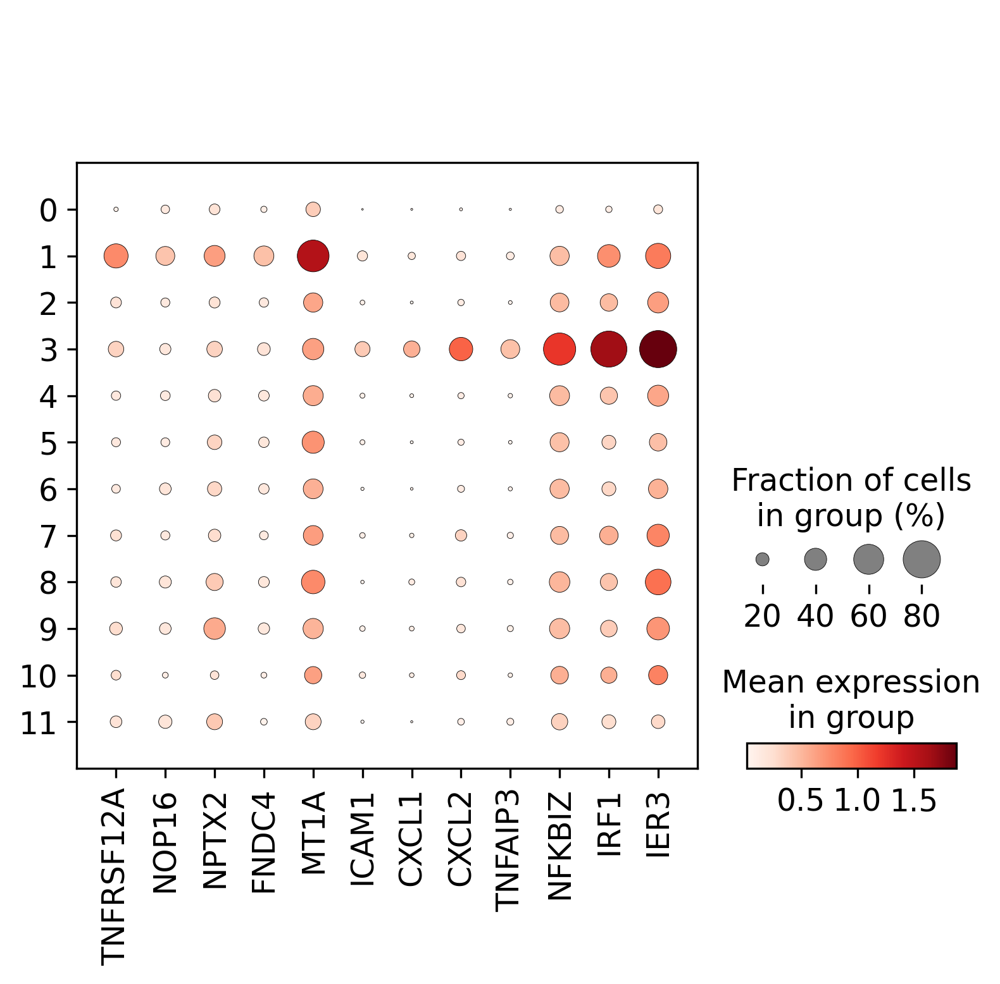

In [91]:
sc.pl.dotplot(adata,['TNFRSF12A', 'NOP16', 'NPTX2', 'FNDC4', 'MT1A','ICAM1', 'CXCL1', 'CXCL2', 
             'TNFAIP3', 'NFKBIZ', 'IRF1', 'IER3',],groupby='leiden')

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


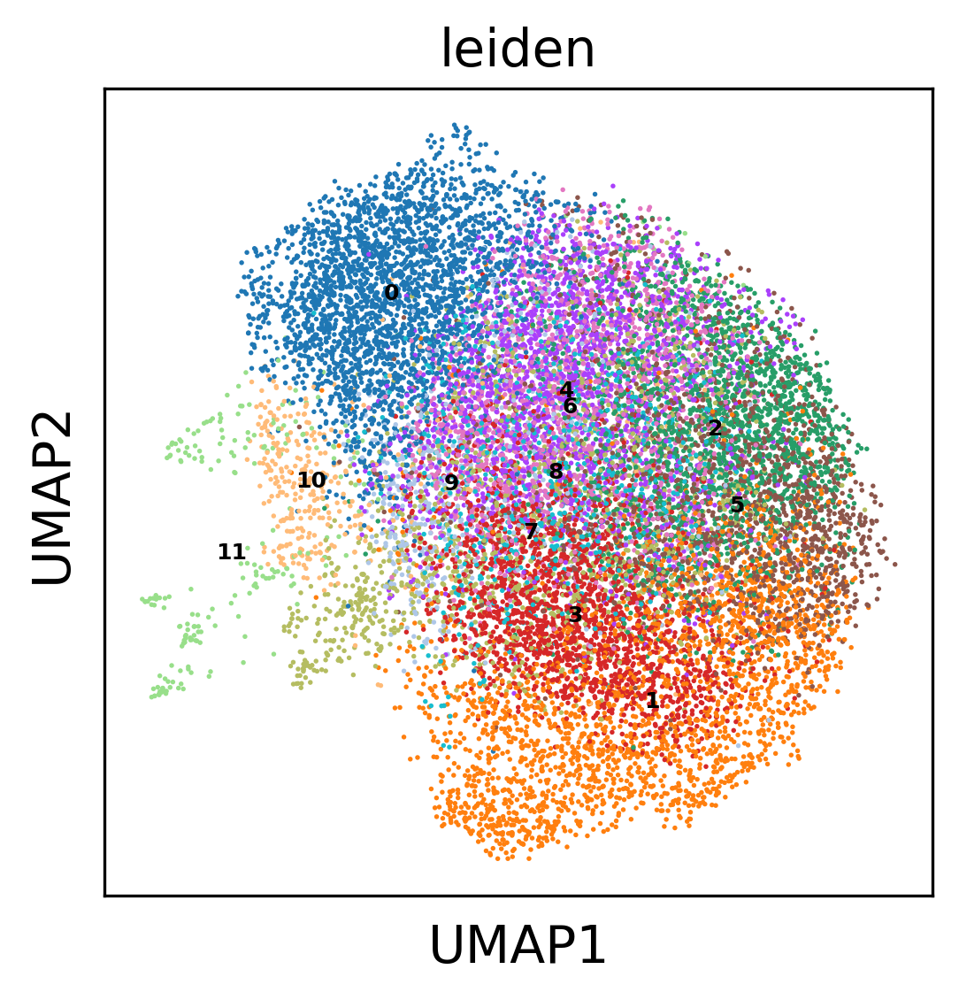

In [90]:
sc.pl.umap(adata, color = ['leiden',],legend_loc='on data',legend_fontsize=6 )

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


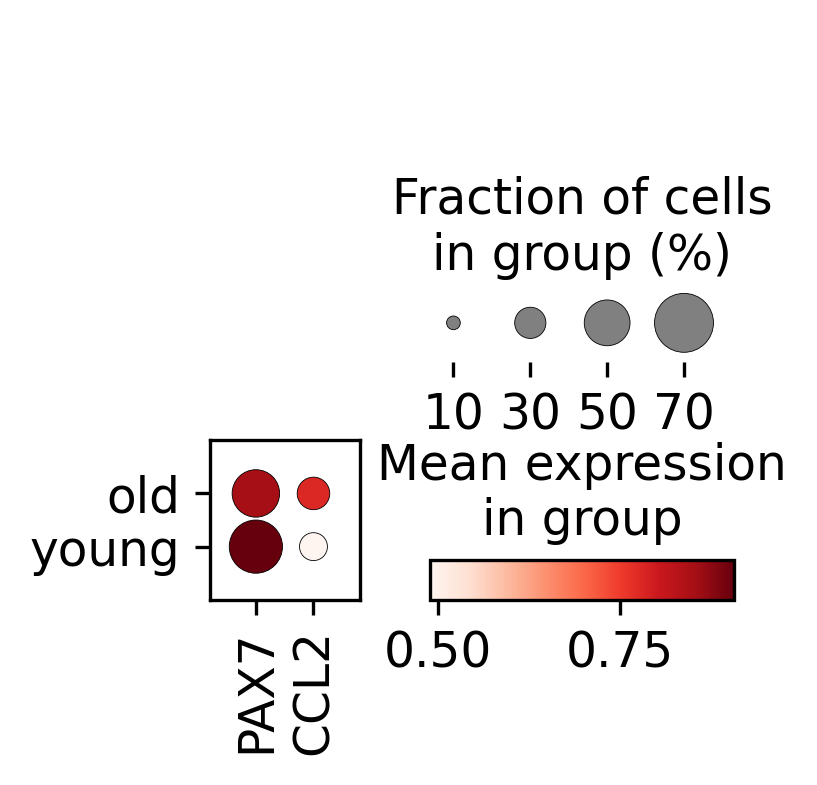

In [95]:
sc.pl.dotplot(adata,['PAX7','CCL2'],groupby=['Age_group'])

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


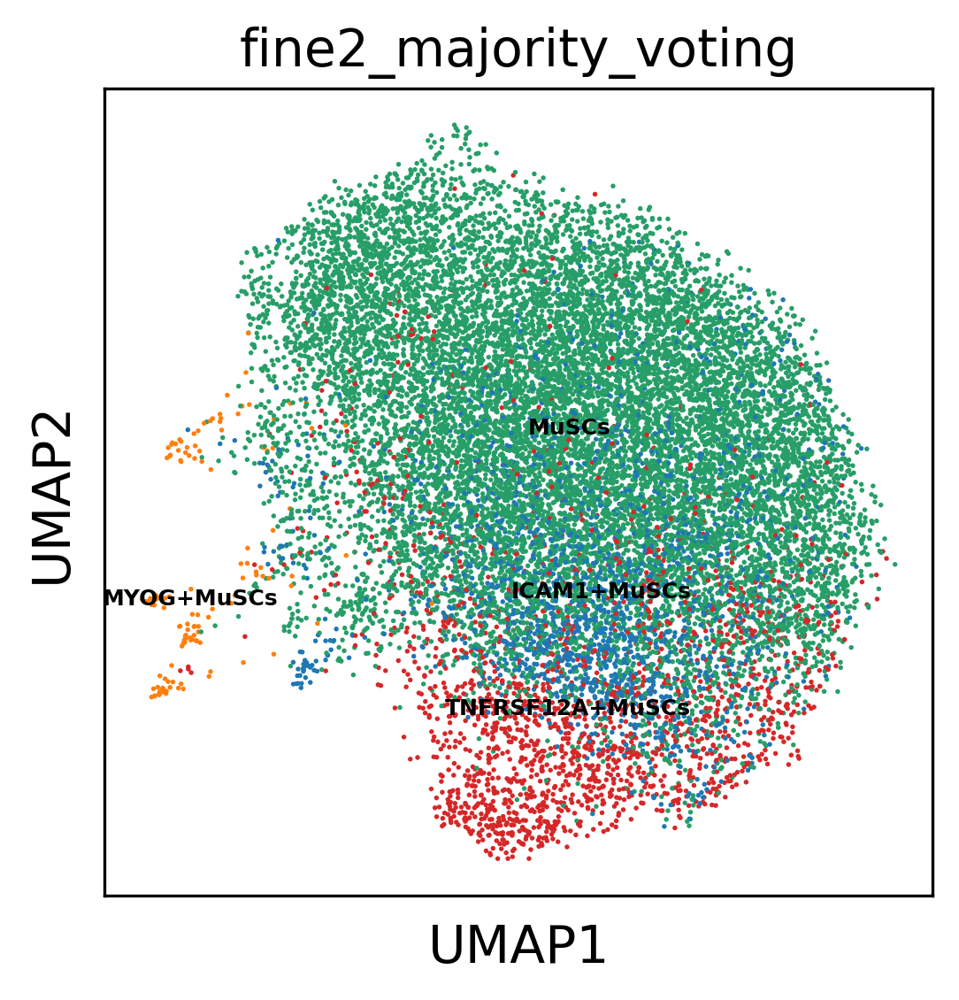

In [4]:
sc.pl.umap(adata, color = ['fine2_majority_voting',],legend_loc='on data',legend_fontsize=6 )

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


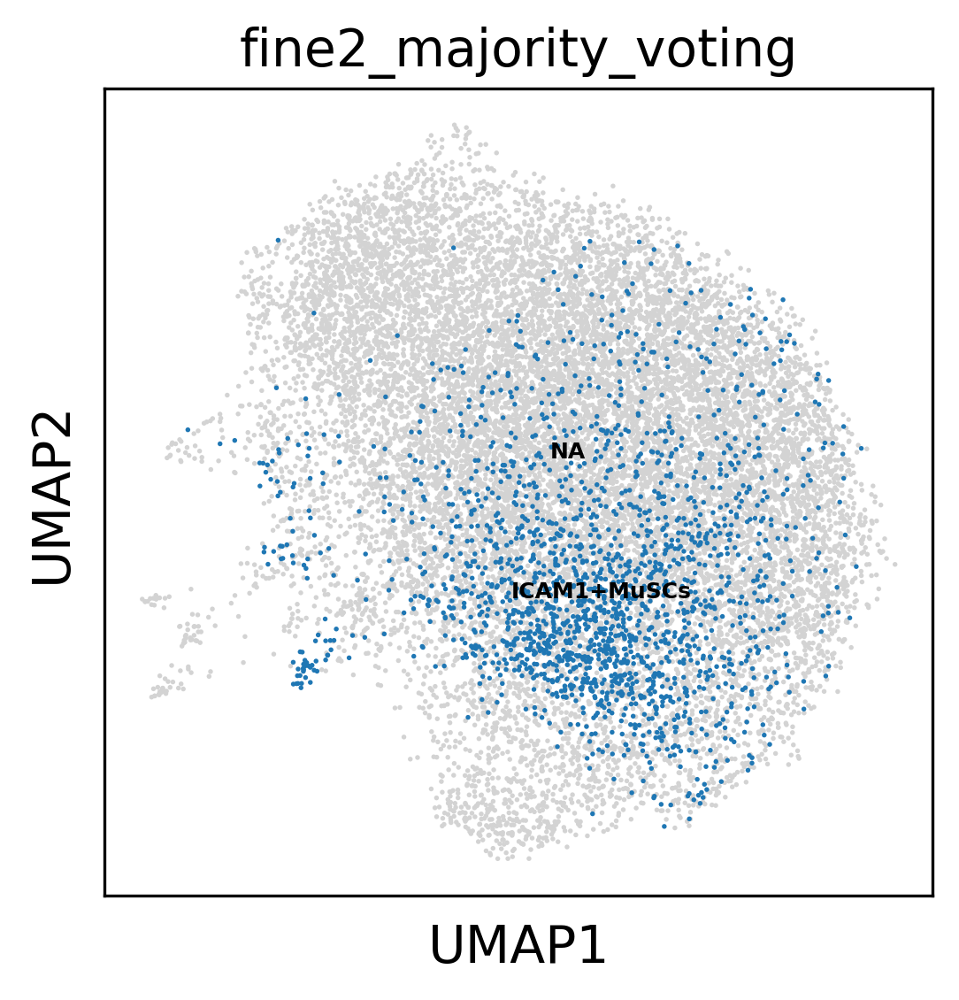

In [7]:
sc.pl.umap(adata, color = ['fine2_majority_voting',],legend_loc='on data',legend_fontsize=6,groups='ICAM1+MuSCs' )

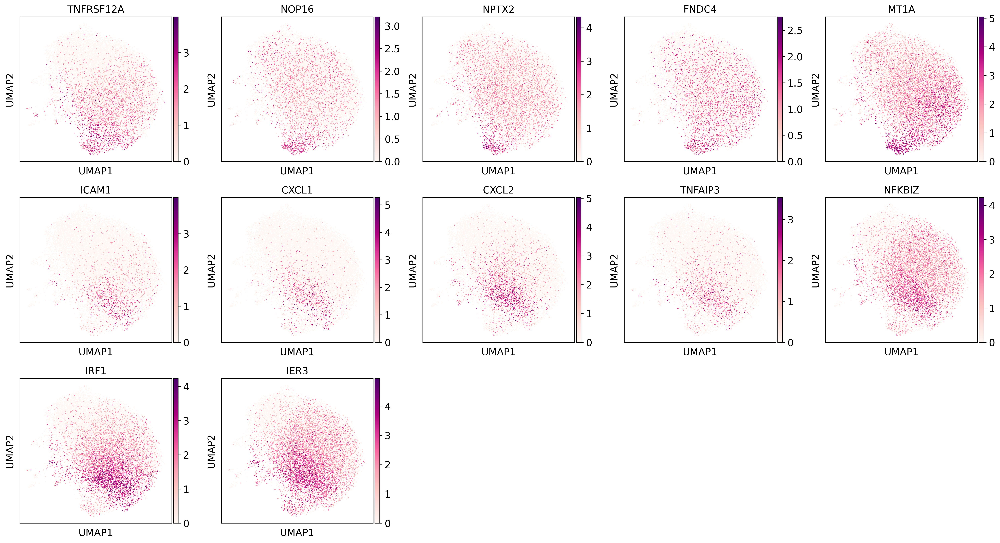

In [22]:
sc.pl.umap(adata,color=['TNFRSF12A', 'NOP16', 'NPTX2', 'FNDC4', 'MT1A','ICAM1', 'CXCL1', 'CXCL2', 
             'TNFAIP3', 'NFKBIZ', 'IRF1', 'IER3', ],ncols=5)

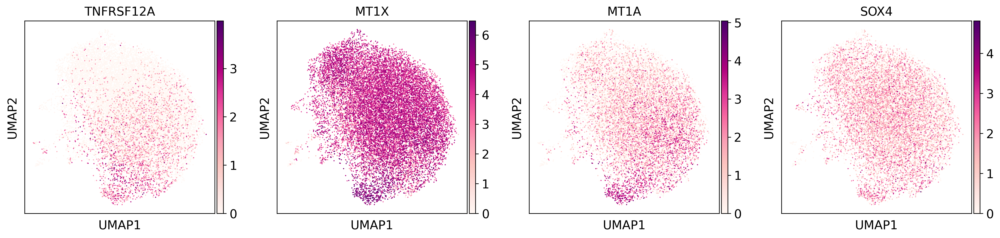

In [85]:
sc.pl.umap(adata,color=['TNFRSF12A','MT1X','MT1A','SOX4'],ncols=5)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


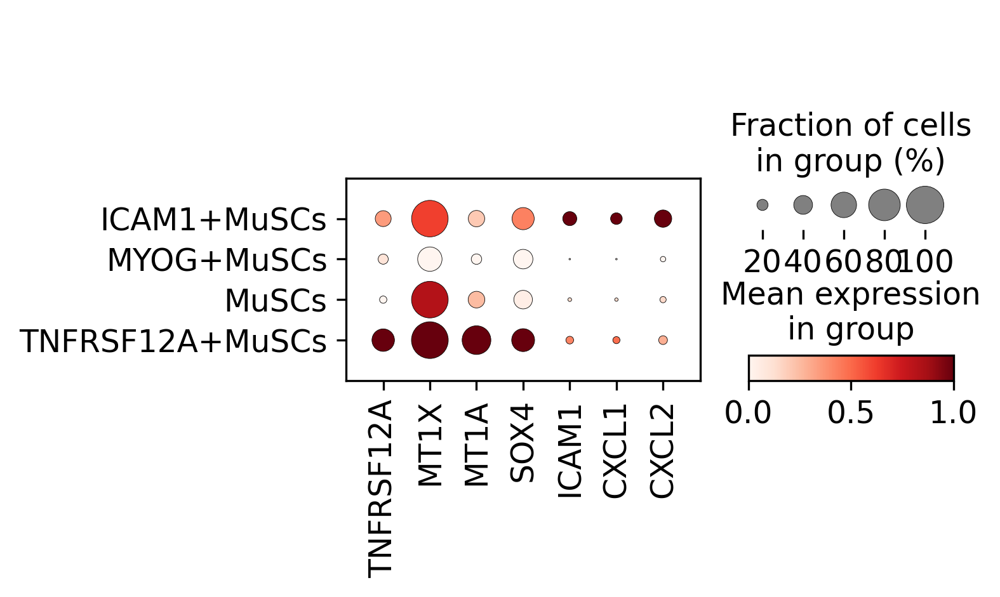

In [89]:
sc.pl.dotplot(adata,['TNFRSF12A','MT1X','MT1A','SOX4','ICAM1', 'CXCL1', 'CXCL2', ],groupby=['fine2_majority_voting'],standard_scale='var',)

In [31]:
adata

AnnData object with n_obs × n_vars = 17554 × 10000
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'is_doublet_scrub', 'annotation_level0', 'annotation_level1', 'annotation_level2', 'sample_type', 'update_status', 'putative_doublet_scvi1', '_scvi_batch', '_scvi_labels', 'leiden', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'fine2_predicted_labels', 'fine2_over_clustering', 'fine2_majority_voting', 'fine2_conf_score', 'score'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts', 'n_cells', 'mean', 'std', '

In [34]:
collections.Counter(adata.obs['fine2_majority_voting'])

Counter({'MYOG+MuSCs': 131,
         'MuSCs': 13551,
         'TNFRSF12A+MuSCs': 1902,
         'ICAM1+MuSCs': 1970})

In [45]:
adata.uns['fine2_majority_voting_colors'] = ['#1f77b4','#d62728','#279e68','#ff7f0e']

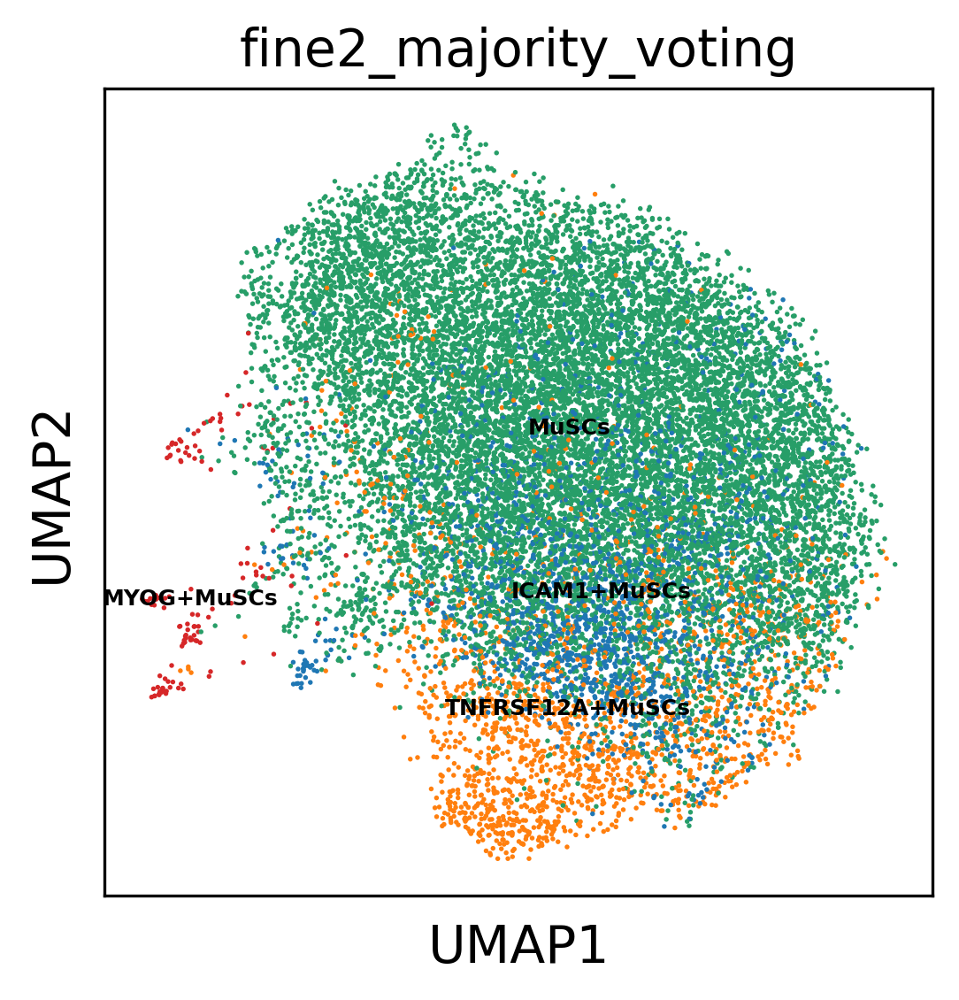

In [47]:
sc.pl.umap(adata, color = ['fine2_majority_voting',],legend_loc='on data',legend_fontsize=6,save='ICM_MuSC_scvi_v2_anno.pdf')

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


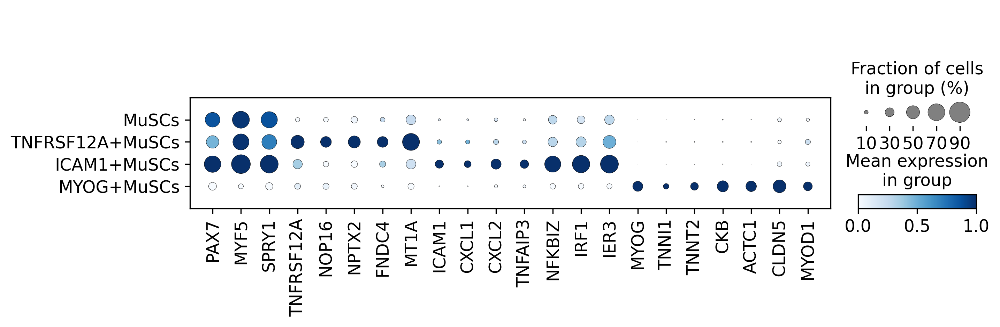

In [27]:
sc.pl.dotplot(adata,['PAX7','MYF5','SPRY1','TNFRSF12A','NOP16','NPTX2','FNDC4','MT1A','ICAM1','CXCL1','CXCL2','TNFAIP3','NFKBIZ','IRF1','IER3','MYOG','TNNI1','TNNT2','CKB','ACTC1','CLDN5','MYOD1'],groupby='fine2_majority_voting',categories_order=['MuSCs','TNFRSF12A+MuSCs','ICAM1+MuSCs','MYOG+MuSCs',],cmap='Blues',standard_scale='var',
         save='ICM_MuSC_scvi_v2_markar_blue.pdf')

In [117]:
adata_ICAM1 = adata[adata.obs['fine2_majority_voting']=='ICAM1+MuSCs']

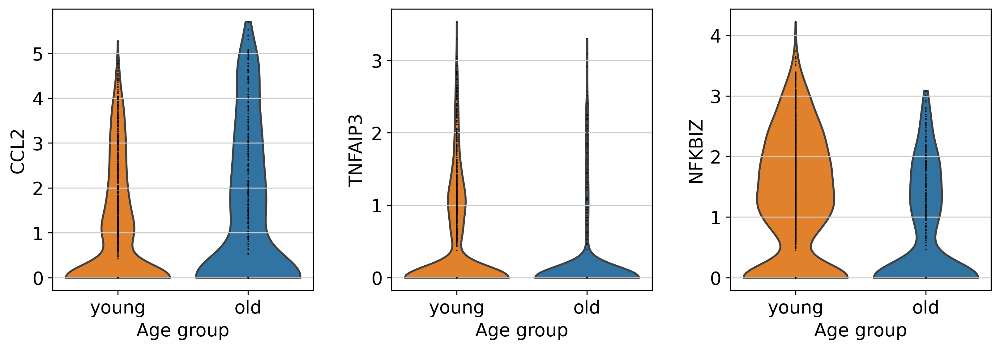

In [56]:
sc.pl.violin(adata_ICAM1,['CCL2','TNFAIP3','NFKBIZ'],groupby='Age_group',
             order=['young','old',],jitter=False,save='ICM_MuSC_scvi_v2_CCL2.pdf')

In [89]:
adata_ICAM1

View of AnnData object with n_obs × n_vars = 1970 × 10000
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'is_doublet_scrub', 'annotation_level0', 'annotation_level1', 'annotation_level2', 'sample_type', 'update_status', 'putative_doublet_scvi1', '_scvi_batch', '_scvi_labels', 'leiden', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'fine2_predicted_labels', 'fine2_over_clustering', 'fine2_majority_voting', 'fine2_conf_score', 'score'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts', 'n_cells', 'mean', '

In [126]:
collections.Counter(adata_ICAM1.obs['Age_group'])

Counter({'old': 481, 'young': 1489})

In [123]:
adata_ICAM1_young = adata_ICAM1[adata_ICAM1.obs['Age_group']=='young']
adata_ICAM1_old = adata_ICAM1[adata_ICAM1.obs['Age_group']=='old']

In [128]:
CCL2_exp_young = adata_ICAM1_young[:,'CCL2'].X.todense()
CCL2_exp_old = adata_ICAM1_old[:,'CCL2'].X.todense()

TNFAIP3_exp_young = adata_ICAM1_young[:,'TNFAIP3'].X.todense()
TNFAIP3_exp_old = adata_ICAM1_old[:,'TNFAIP3'].X.todense()

NFKBIZ_exp_young = adata_ICAM1_young[:,'NFKBIZ'].X.todense()
NFKBIZ_exp_old = adata_ICAM1_old[:,'NFKBIZ'].X.todense()

CCL2_exp_young.shape = (1,1489)
CCL2_exp_old.shape = (1,481)
TNFAIP3_exp_young.shape = (1,1489)
TNFAIP3_exp_old.shape = (1,481)
NFKBIZ_exp_young.shape = (1,1489)
NFKBIZ_exp_old.shape = (1,481)

In [129]:
list(np.array(CCL2_exp_young)[0])

[0.0,
 1.9204623,
 2.2249231,
 0.0,
 0.79695255,
 1.8158045,
 0.0,
 0.0,
 0.853672,
 2.4666684,
 0.0,
 0.8653739,
 0.87390834,
 0.8780787,
 0.0,
 0.0,
 0.0,
 1.3544947,
 0.0,
 2.5408757,
 0.0,
 0.91915023,
 0.0,
 0.0,
 3.2960522,
 0.0,
 3.4057415,
 0.0,
 1.7414976,
 0.0,
 0.0,
 2.7273638,
 0.0,
 0.0,
 3.4437149,
 0.0,
 1.4465271,
 0.0,
 1.44939,
 0.0,
 0.0,
 0.9782325,
 0.9802047,
 0.0,
 2.4026055,
 1.7992991,
 1.4735581,
 3.5064404,
 0.0,
 0.9975914,
 0.0,
 1.8234206,
 0.0,
 1.0083034,
 0.0,
 0.0,
 1.0225624,
 0.0,
 0.0,
 1.8711115,
 0.0,
 0.0,
 0.0,
 0.0,
 3.4521868,
 0.0,
 1.0702388,
 0.0,
 0.0,
 3.1860588,
 0.0,
 2.6908603,
 0.0,
 0.0,
 0.0,
 0.0,
 1.1031663,
 0.0,
 0.0,
 3.2483325,
 0.0,
 1.6365395,
 0.0,
 4.043546,
 0.0,
 0.0,
 1.9933136,
 0.0,
 1.1379744,
 1.6625218,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 1.1731453,
 0.0,
 0.0,
 0.0,
 0.0,
 0.0,
 1.2080247,
 3.9211476,
 0.0,
 3.1231642,
 2.569763,
 1.7641757,
 2.8941982,
 0.0,
 0.0,
 1.796148,
 4.0421944,
 0.0,
 

In [131]:
from scipy import stats

In [132]:
stats.ttest_ind(list(np.array(CCL2_exp_young)[0]),list(np.array(CCL2_exp_old)[0]))

Ttest_indResult(statistic=-5.728778812174615, pvalue=1.167640299027185e-08)

In [133]:
stats.ttest_ind(list(np.array(TNFAIP3_exp_young)[0]),list(np.array(TNFAIP3_exp_old)[0]))

Ttest_indResult(statistic=7.53818827451712, pvalue=7.22808010061258e-14)

In [134]:
stats.ttest_ind(list(np.array(NFKBIZ_exp_young)[0]),list(np.array(NFKBIZ_exp_old)[0]))

Ttest_indResult(statistic=11.267152764598698, pvalue=1.4007473317296908e-28)

***
marker genes

In [5]:
adata

AnnData object with n_obs × n_vars = 17554 × 10000
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'is_doublet_scrub', 'annotation_level0', 'annotation_level1', 'annotation_level2', 'sample_type', 'update_status', 'putative_doublet_scvi1', '_scvi_batch', '_scvi_labels', 'leiden', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'fine2_predicted_labels', 'fine2_over_clustering', 'fine2_majority_voting', 'fine2_conf_score'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts', 'n_cells', 'mean', 'std', 'highly_va

In [6]:
adata.uns['log1p']["base"] = None

In [7]:
sc.tl.rank_genes_groups(adata, 'fine2_majority_voting',method='t-test',corr_method='benjamini-hochberg')

In [8]:
adata

AnnData object with n_obs × n_vars = 17554 × 10000
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'is_doublet_scrub', 'annotation_level0', 'annotation_level1', 'annotation_level2', 'sample_type', 'update_status', 'putative_doublet_scvi1', '_scvi_batch', '_scvi_labels', 'leiden', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'fine2_predicted_labels', 'fine2_over_clustering', 'fine2_majority_voting', 'fine2_conf_score'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts', 'n_cells', 'mean', 'std', 'highly_va

In [9]:
pd.DataFrame(adata.uns['rank_genes_groups']['names'])

,ICAM1+MuSCs,MYOG+MuSCs,MuSCs,TNFRSF12A+MuSCs
0,EGR1,TUBA1B,TSC22D3,MT2A
1,DNAJB1,PFN1,DDIT4,NNMT
2,JUN,TMSB4X,CIRBP,NAMPT
3,JUNB,STMN1,TSC22D1,IFITM3
4,IER2,RAN,NDRG2,MT1A
...,...,...,...,...
33533,RPL41,WISP2,DDX5,CIRBP
33534,DDIT4,PRELP,SOCS3,JUN
33535,RPL39,GALNT15,UGCG,NDRG2
33536,MT1X,CXXC4,NAMPT,TRDN


In [12]:
# 直接保存excel文件
with pd.ExcelWriter('./write/marker_gene/human_MuSC_marker.xlsx') as writer:
    for cell_type_name in list(collections.Counter(adata.obs['fine2_majority_voting'])):
        celltype_list = []
        gene_list = list(pd.DataFrame(adata.uns['rank_genes_groups']['names'])[cell_type_name][np.array(pd.DataFrame(adata.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        score_list = list(pd.DataFrame(adata.uns['rank_genes_groups']['scores'])[cell_type_name][np.array(pd.DataFrame(adata.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        logfc_list = list(pd.DataFrame(adata.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name][np.array(pd.DataFrame(adata.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        pvals_list = list(pd.DataFrame(adata.uns['rank_genes_groups']['pvals'])[cell_type_name][np.array(pd.DataFrame(adata.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        padj_list = list(pd.DataFrame(adata.uns['rank_genes_groups']['pvals_adj'])[cell_type_name][np.array(pd.DataFrame(adata.uns['rank_genes_groups']['pvals_adj'])[cell_type_name]<0.05)*np.array(pd.DataFrame(adata.uns['rank_genes_groups']['logfoldchanges'])[cell_type_name]>0)])
        celltype_list = [cell_type_name]*len(gene_list)
        #result_df = pd.DataFrame({'Celltype':celltype_list,'Gene':gene_list,'Scores':score_list,'Logfoldchanges':logfc_list,'Pvals':pvals_list,'Pvals_adj':padj_list})
        result_df = pd.DataFrame({'Gene':gene_list,'Pvals':pvals_list,'Pvals_adj':padj_list,'Logfoldchanges':logfc_list})
        filename = cell_type_name
        result_df.to_excel(writer,sheet_name=filename,index=False)

***
GO function enrichment

In [14]:
import jp_single

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


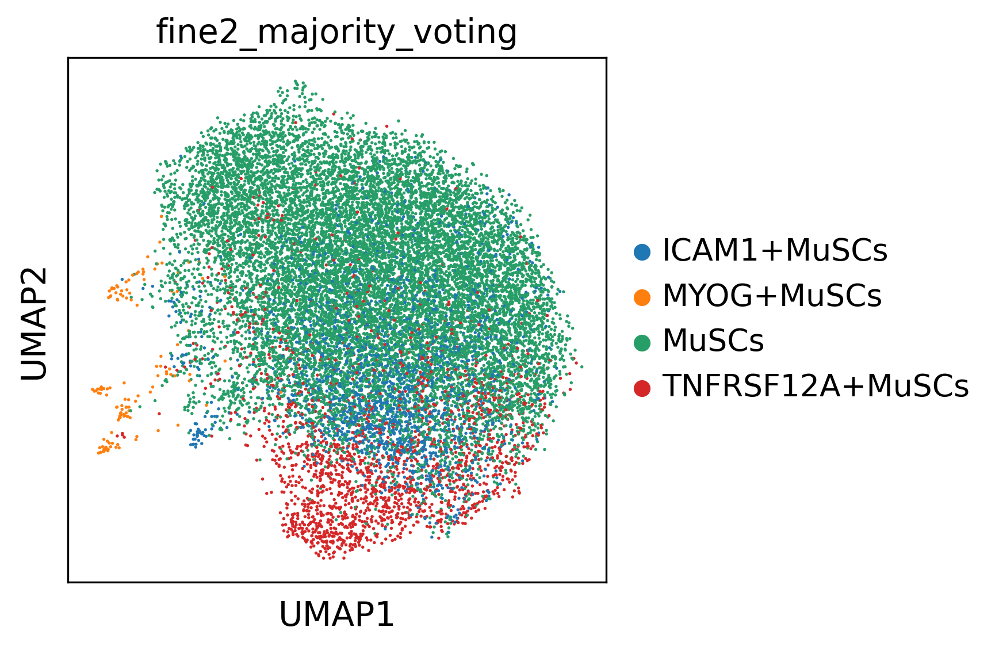

In [15]:
sc.pl.umap(adata, color=['fine2_majority_voting',])

In [23]:
collections.Counter(adata.obs['fine2_majority_voting'])

Counter({'MYOG+MuSCs': 131,
         'MuSCs': 13551,
         'TNFRSF12A+MuSCs': 1902,
         'ICAM1+MuSCs': 1970})

In [24]:
louvain_num = 'ICAM1+MuSCs'

cdm_out = jp_single.calculate_markers(adata,group_key='fine2_majority_voting')

mult_marker_gene = jp_single.find_markers_multiple_v2(adata,cdm_out,thres=0.4,min_exp_cut=0.25)
sorted(mult_marker_gene[louvain_num], key=lambda student: student[1],reverse=True)

[('MYF5', 0.8619361),
 ('CDC42EP4', 0.7487307),
 ('LTBP4', 0.72838455),
 ('NDRG1', 0.7242378),
 ('ABLIM1', 0.71790975),
 ('FP671120.3', 0.7099445),
 ('FP236383.2', 0.70808434),
 ('GABARAPL1', 0.7057883),
 ('MGP', 0.6948419),
 ('FP671120.4', 0.69218063),
 ('ARL5B', 0.67999625),
 ('HYKK', 0.6636771),
 ('LAMA2', 0.65531677),
 ('MTRNR2L8', 0.65455365),
 ('RND3', 0.65196157),
 ('CXCL2', 0.64993566),
 ('TGFBR3', 0.6476847),
 ('TNFAIP3', 0.63948494),
 ('LRP1', 0.6375566),
 ('IRS2', 0.6348583),
 ('PTPRG', 0.6258741),
 ('IRF1', 0.6254236),
 ('MAP1LC3A', 0.62450767),
 ('RORA', 0.6243688),
 ('NFKBIZ', 0.62121546),
 ('SPARCL1', 0.6183701),
 ('CYBRD1', 0.6166401),
 ('PLXDC2', 0.61263144),
 ('PLCG2', 0.6117479),
 ('CHRDL2', 0.60837543),
 ('DLK1', 0.607944),
 ('N4BP2L1', 0.60473824),
 ('MMP2', 0.60267675),
 ('AC245297.3', 0.6006563),
 ('CXCL3', 0.59785855),
 ('TIFA', 0.5928017),
 ('TNS2', 0.59250426),
 ('LTBP3', 0.5763554),
 ('SPRY1', 0.57400936),
 ('WEE1', 0.5726853),
 ('BCL6', 0.5680207),
 ('KDM6B'

In [25]:
head = 6300
list_gene = sorted(mult_marker_gene[louvain_num], key=lambda student: student[1],reverse=True)
if head>len(list_gene):
    head = len(list_gene)
gene_list = []
for i in range(head):
    gene_list.append(list_gene[i][0])
print(gene_list)

['MYF5', 'CDC42EP4', 'LTBP4', 'NDRG1', 'ABLIM1', 'FP671120.3', 'FP236383.2', 'GABARAPL1', 'MGP', 'FP671120.4', 'ARL5B', 'HYKK', 'LAMA2', 'MTRNR2L8', 'RND3', 'CXCL2', 'TGFBR3', 'TNFAIP3', 'LRP1', 'IRS2', 'PTPRG', 'IRF1', 'MAP1LC3A', 'RORA', 'NFKBIZ', 'SPARCL1', 'CYBRD1', 'PLXDC2', 'PLCG2', 'CHRDL2', 'DLK1', 'N4BP2L1', 'MMP2', 'AC245297.3', 'CXCL3', 'TIFA', 'TNS2', 'LTBP3', 'SPRY1', 'WEE1', 'BCL6', 'KDM6B', 'CREBRF', 'TNKS1BP1', 'MIR29B2CHG', 'ICAM1', 'MAX', 'ZFHX3', 'RBMS3', 'ASB5', 'MATN2', 'METRNL', 'ERFE', 'BHLHE40', 'CAMK2N1', 'FNIP1', 'MUSK', 'CHORDC1', 'MT-ATP8', 'ZFP36', 'C1orf21', 'HIST2H2AC', 'SOD2', 'H6PD', 'MORC3', 'LRRN4CL', 'JUNB', 'PKD2', 'RGMA', 'NR4A1', 'PGRMC2', 'CREB5', 'AIP', 'KLF4', 'EDNRB', 'TNFAIP2', 'NOTCH3', 'TUBB2B', 'FRMD3', 'CXCL1', 'EGR1', 'IDS', 'NUDT4', 'EIF2A', 'WASL', 'HES1', 'UTRN', 'TSPYL2', 'GREM1', 'EGFR', 'AC020916.1', 'TXNDC15', 'APP', 'MYADM', 'FOXN3', 'RNF13', 'BCL3', 'BTG2', 'TIPARP', 'DIAPH2', 'SWAP70', 'FOS', 'TRHDE', 'TMX4', 'SYNE1', 'ECE1', '

In [ ]:
# ICAM1+ MuSCs
'MYF5', 'CDC42EP4', 'LTBP4', 'NDRG1', 'ABLIM1', 'FP671120.3', 'FP236383.2', 'GABARAPL1', 'MGP', 'FP671120.4', 'ARL5B', 'HYKK', 'LAMA2', 'MTRNR2L8', 'RND3', 'CXCL2', 'TGFBR3', 'TNFAIP3', 'LRP1', 'IRS2', 'PTPRG', 'IRF1', 'MAP1LC3A', 'RORA', 'NFKBIZ', 'SPARCL1', 'CYBRD1', 'PLXDC2', 'PLCG2', 'CHRDL2', 'DLK1', 'N4BP2L1', 'MMP2', 'AC245297.3', 'CXCL3', 'TIFA', 'TNS2', 'LTBP3', 'SPRY1', 'WEE1', 'BCL6', 'KDM6B', 'CREBRF', 'TNKS1BP1', 'MIR29B2CHG', 'ICAM1', 'MAX', 'ZFHX3', 'RBMS3', 'ASB5', 'MATN2', 'METRNL', 'ERFE', 'BHLHE40', 'CAMK2N1', 'FNIP1', 'MUSK', 'CHORDC1', 'MT-ATP8', 'ZFP36', 'C1orf21', 'HIST2H2AC', 'SOD2', 'H6PD', 'MORC3', 'LRRN4CL', 'JUNB', 'PKD2', 'RGMA', 'NR4A1', 'PGRMC2', 'CREB5', 'AIP', 'KLF4', 'EDNRB', 'TNFAIP2', 'NOTCH3', 'TUBB2B', 'FRMD3', 'CXCL1', 'EGR1', 'IDS', 'NUDT4', 'EIF2A', 'WASL', 'HES1', 'UTRN', 'TSPYL2', 'GREM1', 'EGFR', 'AC020916.1', 'TXNDC15', 'APP', 'MYADM', 'FOXN3', 'RNF13', 'BCL3', 'BTG2', 'TIPARP', 'DIAPH2', 'SWAP70', 'FOS', 'TRHDE', 'TMX4', 'SYNE1', 'ECE1', 'MLF1', 'ENPP5', 'LHFPL6', 'IGF1', 'TSTD1', 'LDLR', 'SNAPC1', 'FILIP1L', 'DDIT3', 'FOSB', 'EGR2', 'PDE4B', 'SQSTM1', 'IER2', 'IER3', 'USP11', 'ZIC1', 'REL', 'PNRC1', 'IL33', 'ATF3', 'SLC3A2', 'SOCS3', 'CCPG1', 'FAM53C', 'USP10', 'SYNPO2', 'DUSP10', 'ABI3BP', 'BIRC3', 'ATP1A2', 'ANKRD65', 'TM2D1', 'TNFAIP6', 'DYNLT3', 'DDX3Y', 'CXXC4', 'SERPINB6', 'PPP1R15B', 'FN1', 'NCKAP1', 'CXCL14', 'TRIM56', 'LPP', 'ZFAND2A', 'ZFYVE16', 'VEZF1', 'CAVIN2', 'HSPA1B', 'LITAF', 'FBN1', 'DUSP1', 'CHURC1', 'CASC4', 'CSRNP1', 'HSPH1', 'NCOA7', 'ASH1L', 'SMYD4', 'SPTBN1', 'PALMD', 'FAM49A', 'NOTCH2', 'VIT', 'DPYSL2', 'RAB21', 'KCNN3', 'RNF217', 'LAMC1', 'NTN4', 'MIER1', 'CNOT4', 'NRIP1', 'DNAJB4', 'GNG12', 'NCALD', 'JUND', 'SAV1', 'BAG3', 'MTRNR2L12', 'DNAJA1', 'ARHGAP6', 'MIDN', 'ADAMTS5', 'CLEC2B', 'FOXP1', 'TRPS1', 'DEDD2', 'IGFBP5'

In [ ]:
# TNFRSF12A+ MuSCs
'ANGPTL4', 'SERPING1', 'PLPP3', 'SRGAP1', 'ADM', 'CLCF1', 'NPTX2', 'NOP16', 'MT1A', 'NPPC', 'SLC39A14', 'C12orf57', 'SLC19A2', 'CEBPD', 'RUNX1', 'THBS1', 'EMP1', 'FNDC4', 'PDPN', 'LRP10', 'MT1G', 'ABCA1', 'ATP6V1B2', 'LIFR', 'SELENOM', 'HMCN2', 'TFPI', 'NNMT', 'PHC2', 'COL4A1', 'CEBPB', 'IRX3', 'TNFRSF12A', 'ZNF703', 'TAGLN', 'SAT1', 'CTGF', 'RCN3', 'ARID5B', 'IL1R1', 'OSMR', 'MEDAG', 'TCIM', 'IFITM2', 'RASD1', 'ZFP36L2', 'KHDRBS3', 'GLUL', 'ARID5A', 'NIP7', 'IFITM3', 'MAFB', 'BICC1', 'PNO1', 'CCDC80', 'C1S', 'CD44', 'STX11', 'UAP1', 'GADD45B', 'KDSR', 'PTGER4', 'DCAF13', 'TUSC1', 'B4GALT1', 'PTPRE', 'CYSTM1', 'NUCB1', 'MIR4435-2HG', 'DDX21', 'CLDND1', 'ELL2', 'SH3BP5', 'LTBR', 'MT1M', 'F3', 'TENT5A', 'MGAT1', 'DIMT1', 'GPC3', 'DAB2', 'SNX9', 'SRPRB', 'STX12', 'GTPBP4', 'C1R', 'PIM3', 'CTSL'

In [26]:
for i in ['MYF5', 'CDC42EP4', 'LTBP4', 'NDRG1', 'ABLIM1', 'FP671120.3', 'FP236383.2', 'GABARAPL1', 'MGP', 'FP671120.4', 'ARL5B', 'HYKK', 'LAMA2', 'MTRNR2L8', 'RND3', 'CXCL2', 'TGFBR3', 'TNFAIP3', 'LRP1', 'IRS2', 'PTPRG', 'IRF1', 'MAP1LC3A', 'RORA', 'NFKBIZ', 'SPARCL1', 'CYBRD1', 'PLXDC2', 'PLCG2', 'CHRDL2', 'DLK1', 'N4BP2L1', 'MMP2', 'AC245297.3', 'CXCL3', 'TIFA', 'TNS2', 'LTBP3', 'SPRY1', 'WEE1', 'BCL6', 'KDM6B', 'CREBRF', 'TNKS1BP1', 'MIR29B2CHG', 'ICAM1', 'MAX', 'ZFHX3', 'RBMS3', 'ASB5', 'MATN2', 'METRNL', 'ERFE', 'BHLHE40', 'CAMK2N1', 'FNIP1', 'MUSK', 'CHORDC1', 'MT-ATP8', 'ZFP36', 'C1orf21', 'HIST2H2AC', 'SOD2', 'H6PD', 'MORC3', 'LRRN4CL', 'JUNB', 'PKD2', 'RGMA', 'NR4A1', 'PGRMC2', 'CREB5', 'AIP', 'KLF4', 'EDNRB', 'TNFAIP2', 'NOTCH3', 'TUBB2B', 'FRMD3', 'CXCL1', 'EGR1', 'IDS', 'NUDT4', 'EIF2A', 'WASL', 'HES1', 'UTRN', 'TSPYL2', 'GREM1', 'EGFR', 'AC020916.1', 'TXNDC15', 'APP', 'MYADM', 'FOXN3', 'RNF13', 'BCL3', 'BTG2', 'TIPARP', 'DIAPH2', 'SWAP70', 'FOS', 'TRHDE', 'TMX4', 'SYNE1', 'ECE1', 'MLF1', 'ENPP5', 'LHFPL6', 'IGF1', 'TSTD1', 'LDLR', 'SNAPC1', 'FILIP1L', 'DDIT3', 'FOSB', 'EGR2', 'PDE4B', 'SQSTM1', 'IER2', 'IER3', 'USP11', 'ZIC1', 'REL', 'PNRC1', 'IL33', 'ATF3', 'SLC3A2', 'SOCS3', 'CCPG1', 'FAM53C', 'USP10', 'SYNPO2', 'DUSP10', 'ABI3BP', 'BIRC3', 'ATP1A2', 'ANKRD65', 'TM2D1', 'TNFAIP6', 'DYNLT3', 'DDX3Y', 'CXXC4', 'SERPINB6', 'PPP1R15B', 'FN1', 'NCKAP1', 'CXCL14', 'TRIM56', 'LPP', 'ZFAND2A', 'ZFYVE16', 'VEZF1', 'CAVIN2', 'HSPA1B', 'LITAF', 'FBN1', 'DUSP1', 'CHURC1', 'CASC4', 'CSRNP1', 'HSPH1', 'NCOA7', 'ASH1L', 'SMYD4', 'SPTBN1', 'PALMD', 'FAM49A', 'NOTCH2', 'VIT', 'DPYSL2', 'RAB21', 'KCNN3', 'RNF217', 'LAMC1', 'NTN4', 'MIER1', 'CNOT4', 'NRIP1', 'DNAJB4', 'GNG12', 'NCALD', 'JUND', 'SAV1', 'BAG3', 'MTRNR2L12', 'DNAJA1', 'ARHGAP6', 'MIDN', 'ADAMTS5', 'CLEC2B', 'FOXP1', 'TRPS1', 'DEDD2', 'IGFBP5']:
    print(i)

MYF5
CDC42EP4
LTBP4
NDRG1
ABLIM1
FP671120.3
FP236383.2
GABARAPL1
MGP
FP671120.4
ARL5B
HYKK
LAMA2
MTRNR2L8
RND3
CXCL2
TGFBR3
TNFAIP3
LRP1
IRS2
PTPRG
IRF1
MAP1LC3A
RORA
NFKBIZ
SPARCL1
CYBRD1
PLXDC2
PLCG2
CHRDL2
DLK1
N4BP2L1
MMP2
AC245297.3
CXCL3
TIFA
TNS2
LTBP3
SPRY1
WEE1
BCL6
KDM6B
CREBRF
TNKS1BP1
MIR29B2CHG
ICAM1
MAX
ZFHX3
RBMS3
ASB5
MATN2
METRNL
ERFE
BHLHE40
CAMK2N1
FNIP1
MUSK
CHORDC1
MT-ATP8
ZFP36
C1orf21
HIST2H2AC
SOD2
H6PD
MORC3
LRRN4CL
JUNB
PKD2
RGMA
NR4A1
PGRMC2
CREB5
AIP
KLF4
EDNRB
TNFAIP2
NOTCH3
TUBB2B
FRMD3
CXCL1
EGR1
IDS
NUDT4
EIF2A
WASL
HES1
UTRN
TSPYL2
GREM1
EGFR
AC020916.1
TXNDC15
APP
MYADM
FOXN3
RNF13
BCL3
BTG2
TIPARP
DIAPH2
SWAP70
FOS
TRHDE
TMX4
SYNE1
ECE1
MLF1
ENPP5
LHFPL6
IGF1
TSTD1
LDLR
SNAPC1
FILIP1L
DDIT3
FOSB
EGR2
PDE4B
SQSTM1
IER2
IER3
USP11
ZIC1
REL
PNRC1
IL33
ATF3
SLC3A2
SOCS3
CCPG1
FAM53C
USP10
SYNPO2
DUSP10
ABI3BP
BIRC3
ATP1A2
ANKRD65
TM2D1
TNFAIP6
DYNLT3
DDX3Y
CXXC4
SERPINB6
PPP1R15B
FN1
NCKAP1
CXCL14
TRIM56
LPP
ZFAND2A
ZFYVE16
VEZF1
CAVIN2
HSPA1B
LITAF
FBN1


***
ribosome biogenesis fraction

In [4]:
collections.Counter(adata.obs['fine2_majority_voting'])

Counter({'MYOG+MuSCs': 131,
         'MuSCs': 13551,
         'TNFRSF12A+MuSCs': 1902,
         'ICAM1+MuSCs': 1970})

In [7]:
adata_CD54 = adata[adata.obs['fine2_majority_voting']=='ICAM1+MuSCs']
adata_main = adata[adata.obs['fine2_majority_voting']=='MuSCs']
adata_MYOG = adata[adata.obs['fine2_majority_voting']=='MYOG+MuSCs']
adata_TNFR = adata[adata.obs['fine2_majority_voting']=='TNFRSF12A+MuSCs']

In [11]:
collections.Counter(adata_main.obs['Age_group'])
collections.Counter(adata_CD54.obs['Age_group'])
collections.Counter(adata_TNFR.obs['Age_group'])
collections.Counter(adata_MYOG.obs['Age_group'])

Counter({'old': 5090, 'young': 8461})

Counter({'old': 481, 'young': 1489})

Counter({'old': 857, 'young': 1045})

Counter({'old': 61, 'young': 70})

In [38]:
fraction = []
cytokines_gene_list = ['POLR1A','POLR1B','POLR1C','POLR1D']
celltypes = []
for celltype in list(collections.Counter(adata.obs['fine2_majority_voting'])):
    for i in cytokines_gene_list:
        fraction.append(adata[adata.obs['fine2_majority_voting']==celltype][adata[adata.obs['fine2_majority_voting']==celltype].obs['Age_group']=='old'].raw[:,i].X.size/collections.Counter(adata[adata.obs['fine2_majority_voting']==celltype].obs['Age_group'])['old'])
    gene = cytokines_gene_list*4
    celltypes = celltypes+[celltype]*len(cytokines_gene_list)

fraction_df = pd.DataFrame({'gene' : gene,'fraction':fraction,'cell_type':celltypes})
fraction_df

,gene,fraction,cell_type
0,POLR1A,0.081967,MYOG+MuSCs
1,POLR1B,0.000000,MYOG+MuSCs
2,POLR1C,0.065574,MYOG+MuSCs
3,POLR1D,0.377049,MYOG+MuSCs
4,POLR1A,0.061886,MuSCs
5,POLR1B,0.018861,MuSCs
6,POLR1C,0.051866,MuSCs
7,POLR1D,0.384872,MuSCs
8,POLR1A,0.091015,TNFRSF12A+MuSCs
9,POLR1B,0.031505,TNFRSF12A+MuSCs


In [34]:
ribosome_gene_list = ['POLR1A','POLR1B','POLR1C','POLR1D','RPA3','POLR1E','WDR74','WDR3','MRTO4','EBNA1BP2','RRS1','RRP1','RRP9','BRIX1','IMP4','UTP3','NOP56','NOP58','DCAF13','NOB1','MPHOSPH10','GAR1','DDX21','NIP7','SURF6','SNRPB']

fraction_main_MuSC = []
for i in ribosome_gene_list:
    fraction_main_MuSC.append(adata_main[adata_main.obs['Age_group']=='old'].raw[:,i].X.size/5090)

fraction_CD54_MuSC = []
for i in ribosome_gene_list:
    fraction_CD54_MuSC.append(adata_CD54[adata_CD54.obs['Age_group']=='old'].raw[:,i].X.size/481)

fraction_TNFR_MuSC = []
for i in ribosome_gene_list:
    fraction_TNFR_MuSC.append(adata_TNFR[adata_TNFR.obs['Age_group']=='old'].raw[:,i].X.size/857)

fraction_MYOG_MuSC = []
for i in ribosome_gene_list:
    fraction_MYOG_MuSC.append(adata_MYOG[adata_MYOG.obs['Age_group']=='old'].raw[:,i].X.size/61)

fraction = fraction_main_MuSC+fraction_CD54_MuSC+fraction_TNFR_MuSC+fraction_MYOG_MuSC
gene = ['POLR1A','POLR1B','POLR1C','POLR1D','RPA3','POLR1E','WDR74','WDR3','MRTO4','EBNA1BP2','RRS1','RRP1','RRP9','BRIX1','IMP4','UTP3','NOP56','NOP58','DCAF13','NOB1','MPHOSPH10','GAR1','DDX21','NIP7','SURF6','SNRPB']*4
celltype = ['MuSCs']*len(ribosome_gene_list)+['ICAM1+MuSCs']*len(ribosome_gene_list)+['TNFRSF12A+MuSCs']*len(ribosome_gene_list)+['MYOG+MuSCs']*len(ribosome_gene_list)

fraction_df = pd.DataFrame({'gene' : gene,'fraction':fraction,'cell_type':celltype})
fraction_df

fraction_df.to_csv('./write/ICM_MuSC_scvi_v2_ribosome_biogenesis_fraction.csv')

,gene,fraction,cell_type
0,POLR1A,0.061886,MuSCs
1,POLR1B,0.018861,MuSCs
2,POLR1C,0.051866,MuSCs
3,POLR1D,0.384872,MuSCs
4,RPA3,0.114145,MuSCs
...,...,...,...
99,GAR1,0.213115,MYOG+MuSCs
100,DDX21,0.442623,MYOG+MuSCs
101,NIP7,0.098361,MYOG+MuSCs
102,SURF6,0.114754,MYOG+MuSCs


In [36]:
ribosome_gene_list = ['RPLP0','RPL3','RPL4','RPL5','RPL6','RPL7','RPL7A','RPL8','RPL9','RPL10','RPL11','RPL12','RPL13','RPL13A','RPL14','RPL15','RPL17','RPL18','RPL18A','RPL19','RPL21','RPL22','RPL22L1',
'RPL23','RPL23A','RPL24','RPL26','RPL27','RPL27A','RPL28','RPL29','RPL30','RPL31','RPL32','RPL34',
'RPL35','RPL35A','RPL36','RPL36A','RPL37','RPL37A','RPL38','RPL39','RPL41','RPSA','RPS2','RPS3','RPS3A','RPS4Y1','RPS4Y2','RPS4X','RPS5','RPS6','RPS7','RPS8','RPS9','RPS10','RPS11','RPS12','RPS13','RPS14',
'RPS15','RPS16','RPS17','RPS18','RPS19','RPS20','RPS21','RPS23','RPS24','RPS25','RPS26','RPS27','RPS27A','RPS28','RPS29']

fraction_main_MuSC = []
for i in ribosome_gene_list:
    fraction_main_MuSC.append(adata_main[adata_main.obs['Age_group']=='young'].raw[:,i].X.size/8461)

fraction_CD54_MuSC = []
for i in ribosome_gene_list:
    fraction_CD54_MuSC.append(adata_CD54[adata_CD54.obs['Age_group']=='young'].raw[:,i].X.size/1489)

fraction_TNFR_MuSC = []
for i in ribosome_gene_list:
    fraction_TNFR_MuSC.append(adata_TNFR[adata_TNFR.obs['Age_group']=='young'].raw[:,i].X.size/1045)

fraction_MYOG_MuSC = []
for i in ribosome_gene_list:
    fraction_MYOG_MuSC.append(adata_MYOG[adata_MYOG.obs['Age_group']=='young'].raw[:,i].X.size/70)

fraction = fraction_main_MuSC+fraction_CD54_MuSC+fraction_TNFR_MuSC+fraction_MYOG_MuSC
gene = ['RPLP0','RPL3','RPL4','RPL5','RPL6','RPL7','RPL7A','RPL8','RPL9','RPL10','RPL11','RPL12','RPL13','RPL13A','RPL14','RPL15','RPL17','RPL18','RPL18A','RPL19','RPL21','RPL22','RPL22L1',
'RPL23','RPL23A','RPL24','RPL26','RPL27','RPL27A','RPL28','RPL29','RPL30','RPL31','RPL32','RPL34',
'RPL35','RPL35A','RPL36','RPL36A','RPL37','RPL37A','RPL38','RPL39','RPL41','RPSA','RPS2','RPS3','RPS3A','RPS4Y1','RPS4Y2','RPS4X','RPS5','RPS6','RPS7','RPS8','RPS9','RPS10','RPS11','RPS12','RPS13','RPS14',
'RPS15','RPS16','RPS17','RPS18','RPS19','RPS20','RPS21','RPS23','RPS24','RPS25','RPS26','RPS27','RPS27A','RPS28','RPS29']*4
celltype = ['MuSCs']*len(ribosome_gene_list)+['ICAM1+MuSCs']*len(ribosome_gene_list)+['TNFRSF12A+MuSCs']*len(ribosome_gene_list)+['MYOG+MuSCs']*len(ribosome_gene_list)

fraction_df = pd.DataFrame({'gene' : gene,'fraction':fraction,'cell_type':celltype})

fraction_df.to_csv('./write/ICM_MuSC_scvi_v2_ribosome_protein_fraction.csv')

In [37]:
fraction_df

,gene,fraction,cell_type
0,RPLP0,0.991254,MuSCs
1,RPL3,0.998109,MuSCs
2,RPL4,0.978844,MuSCs
3,RPL5,0.994445,MuSCs
4,RPL6,0.996218,MuSCs
...,...,...,...
299,RPS26,0.842857,MYOG+MuSCs
300,RPS27,0.957143,MYOG+MuSCs
301,RPS27A,1.000000,MYOG+MuSCs
302,RPS28,0.985714,MYOG+MuSCs


/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


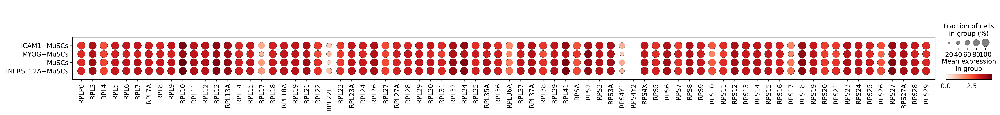

In [57]:
sc.pl.dotplot(adata,ribosome_gene_list,groupby=['fine2_majority_voting'])

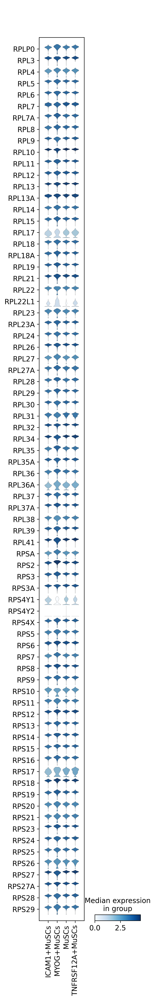

In [61]:
sc.pl.stacked_violin(adata,ribosome_gene_list,groupby=['fine2_majority_voting'],swap_axes=True,save='ICM_MuSC_scvi_v2_ribosome_protein.pdf')

In [56]:
adata

AnnData object with n_obs × n_vars = 17554 × 10000
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'is_doublet_scrub', 'annotation_level0', 'annotation_level1', 'annotation_level2', 'sample_type', 'update_status', 'putative_doublet_scvi1', '_scvi_batch', '_scvi_labels', 'leiden', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'fine2_predicted_labels', 'fine2_over_clustering', 'fine2_majority_voting', 'fine2_conf_score'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts', 'n_cells', 'mean', 'std', 'highly_va

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


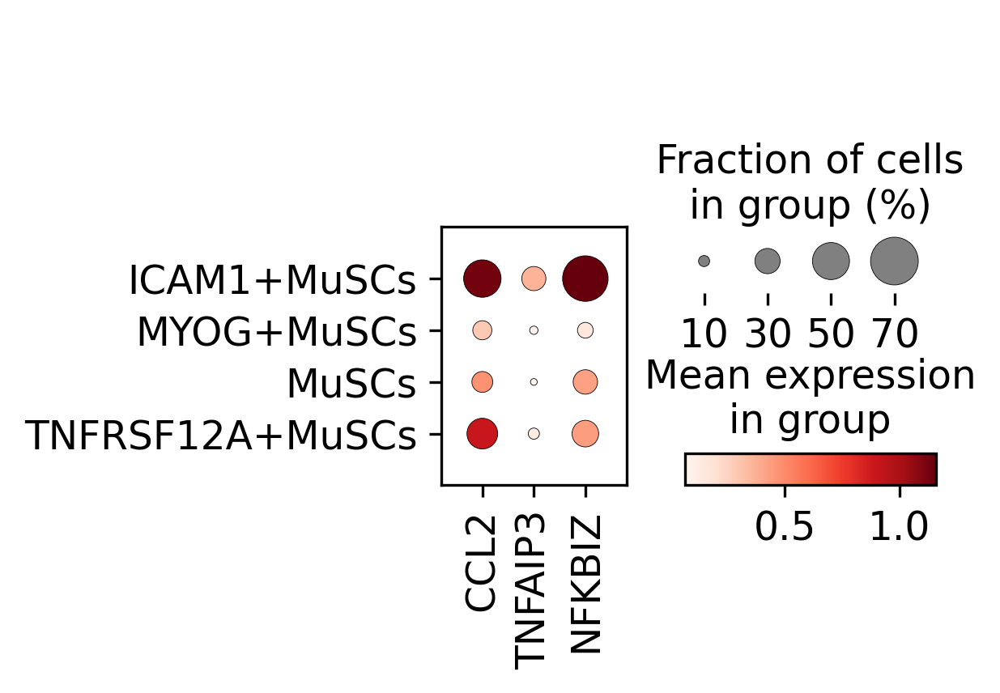

In [84]:
sc.pl.dotplot(adata,['CCL2','TNFAIP3','NFKBIZ'],groupby='fine2_majority_voting')

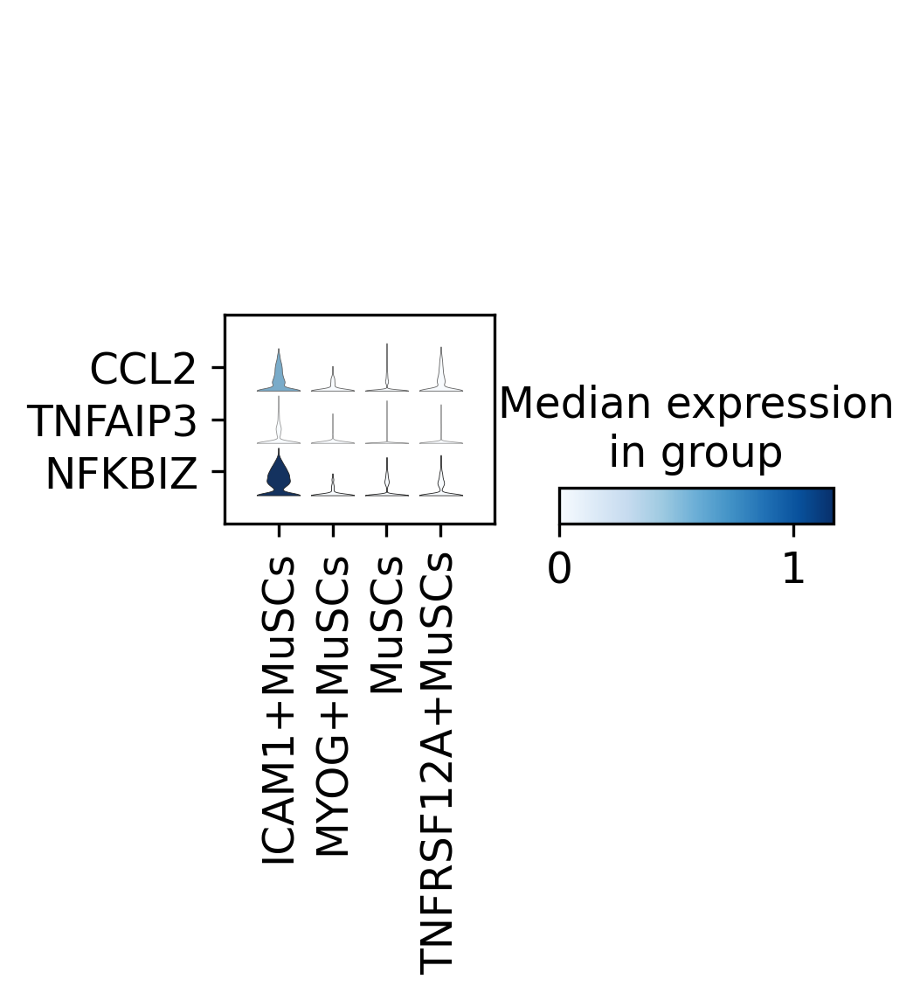

In [82]:
sc.pl.stacked_violin(adata,['CCL2','TNFAIP3','NFKBIZ'],groupby='fine2_majority_voting',swap_axes=True)

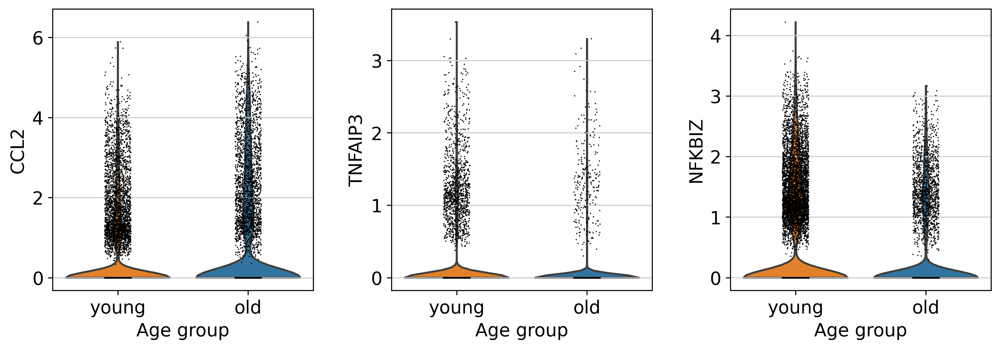

In [74]:
sc.pl.violin(adata,['CCL2','TNFAIP3','NFKBIZ'],groupby='Age_group',order=['young','old',],)

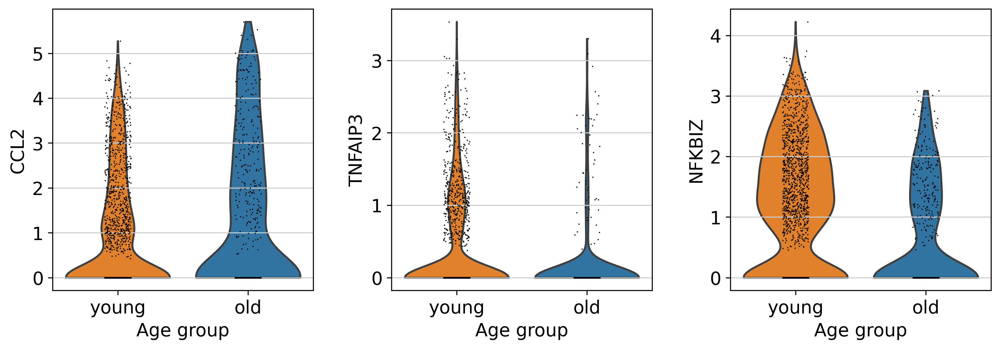

In [75]:
sc.pl.violin(adata_CD54,['CCL2','TNFAIP3','NFKBIZ'],groupby='Age_group',order=['young','old',],)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


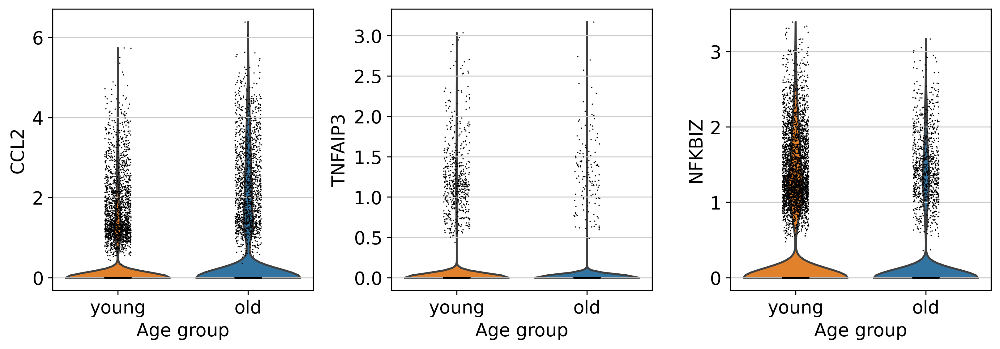

In [76]:
sc.pl.violin(adata_main,['CCL2','TNFAIP3','NFKBIZ'],groupby='Age_group',order=['young','old',],)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


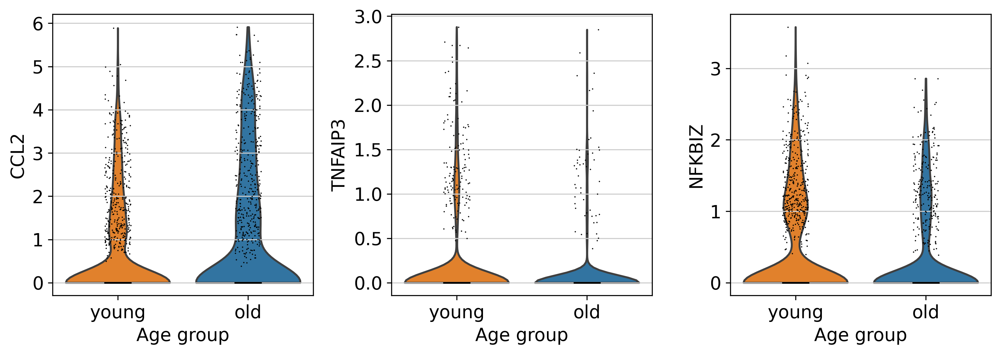

In [77]:
sc.pl.violin(adata_TNFR,['CCL2','TNFAIP3','NFKBIZ'],groupby='Age_group',order=['young','old',],)

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


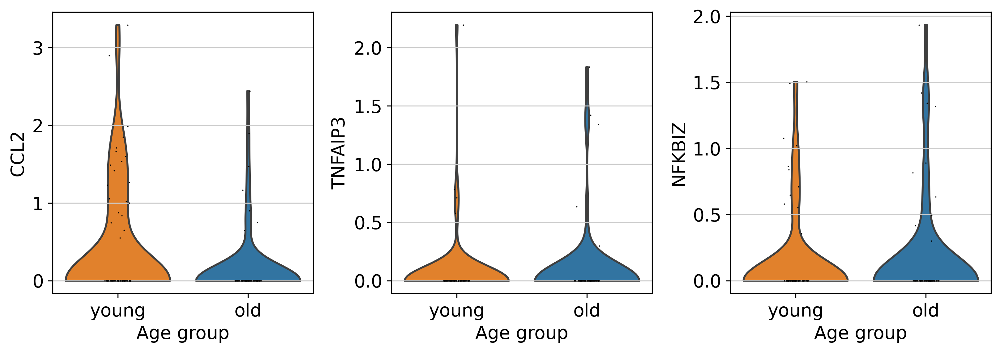

In [78]:
sc.pl.violin(adata_MYOG,['CCL2','TNFAIP3','NFKBIZ'],groupby='Age_group',order=['young','old',],)

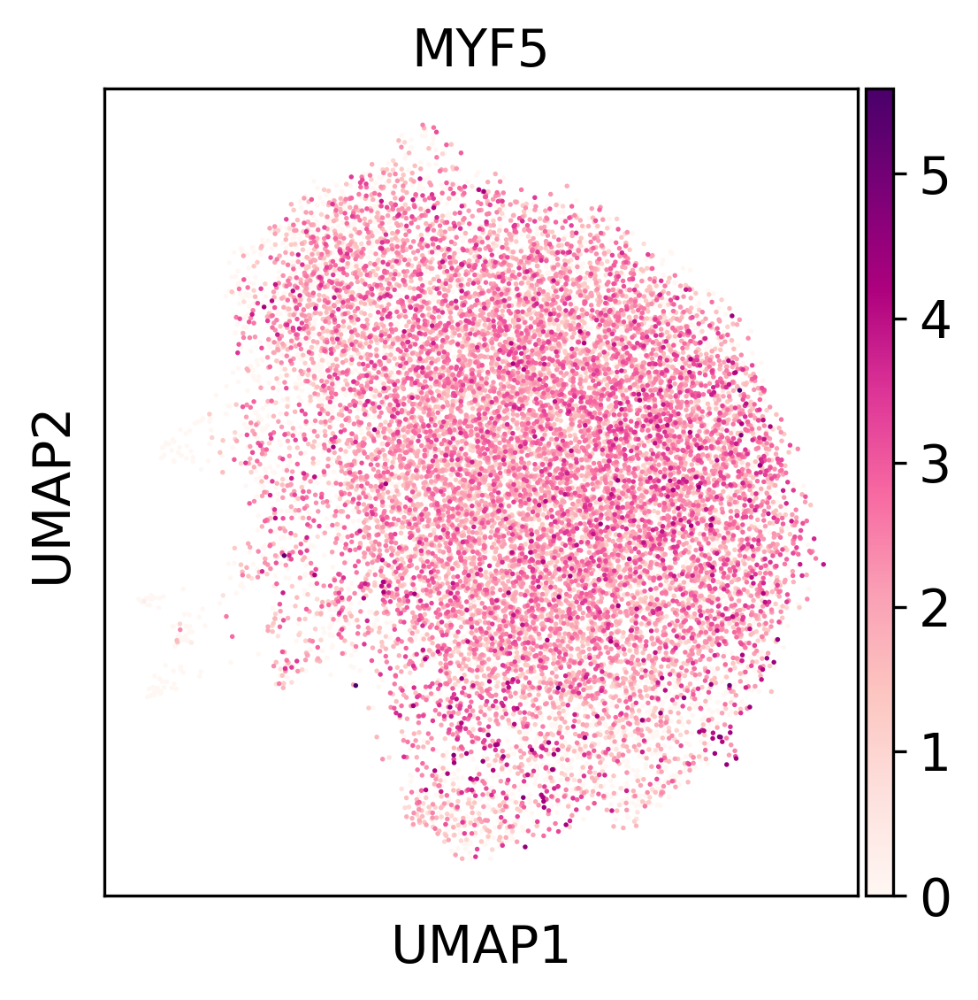

In [27]:
sc.pl.umap(adata, color=['MYF5',])

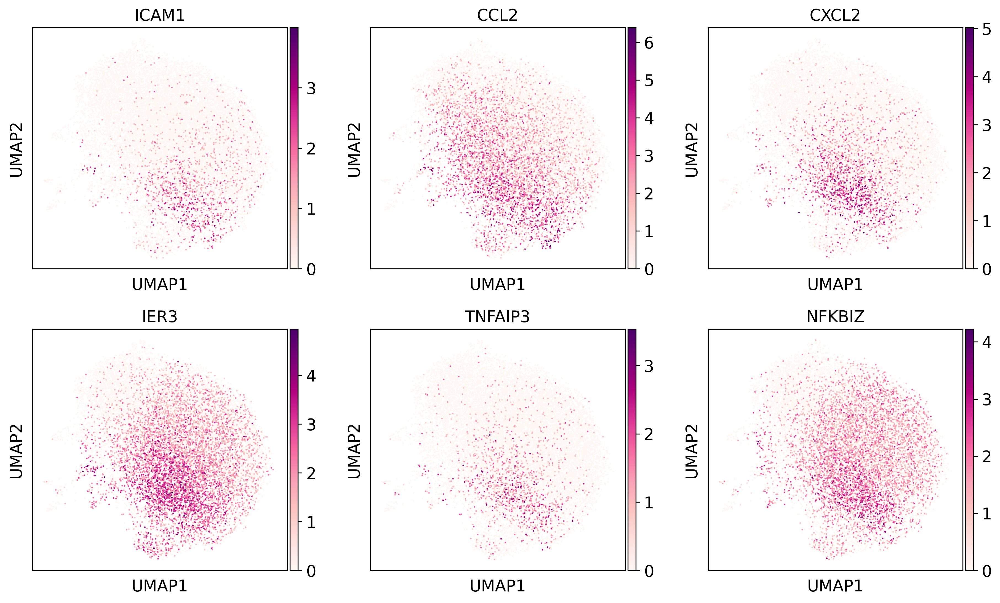

In [30]:
sc.pl.umap(adata,color=['ICAM1', 'CCL2', 'CXCL2','IER3', 'TNFAIP3','NFKBIZ',],ncols=3,save='ICM_MuSC_scvi_v2_mark2.pdf')

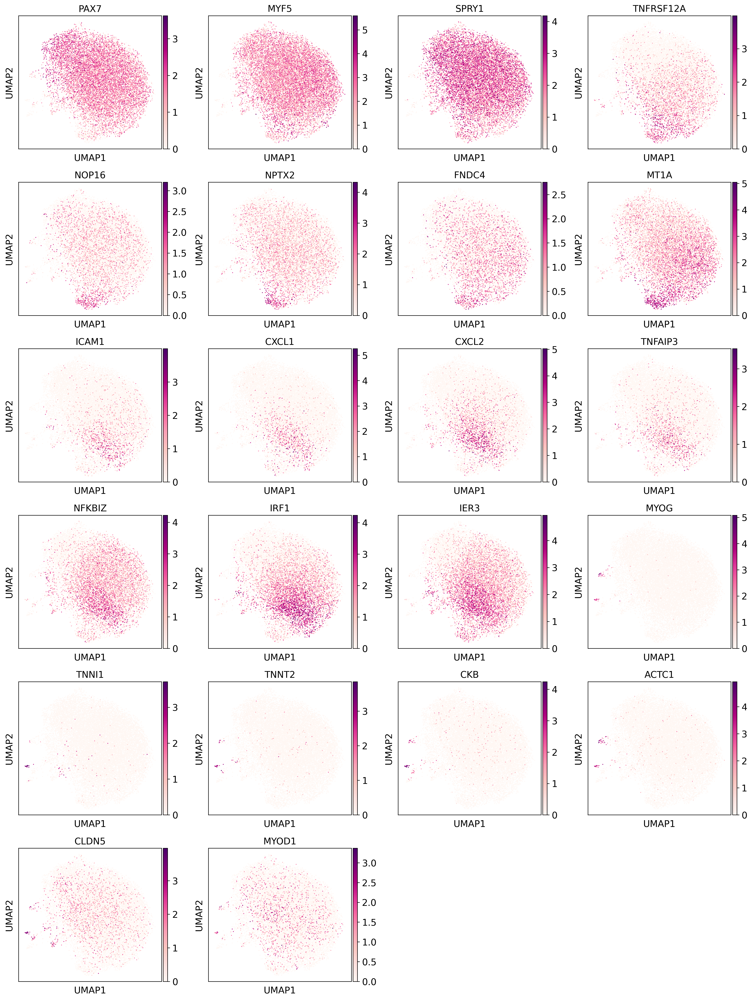

In [6]:
sc.pl.umap(adata,color=['PAX7', 'MYF5', 'SPRY1', 'TNFRSF12A', 'NOP16', 'NPTX2', 'FNDC4', 'MT1A', 'ICAM1', 'CXCL1', 'CXCL2', 
             'TNFAIP3', 'NFKBIZ', 'IRF1', 'IER3', 'MYOG', 'TNNI1', 'TNNT2', 'CKB', 'ACTC1', 'CLDN5', 'MYOD1'])

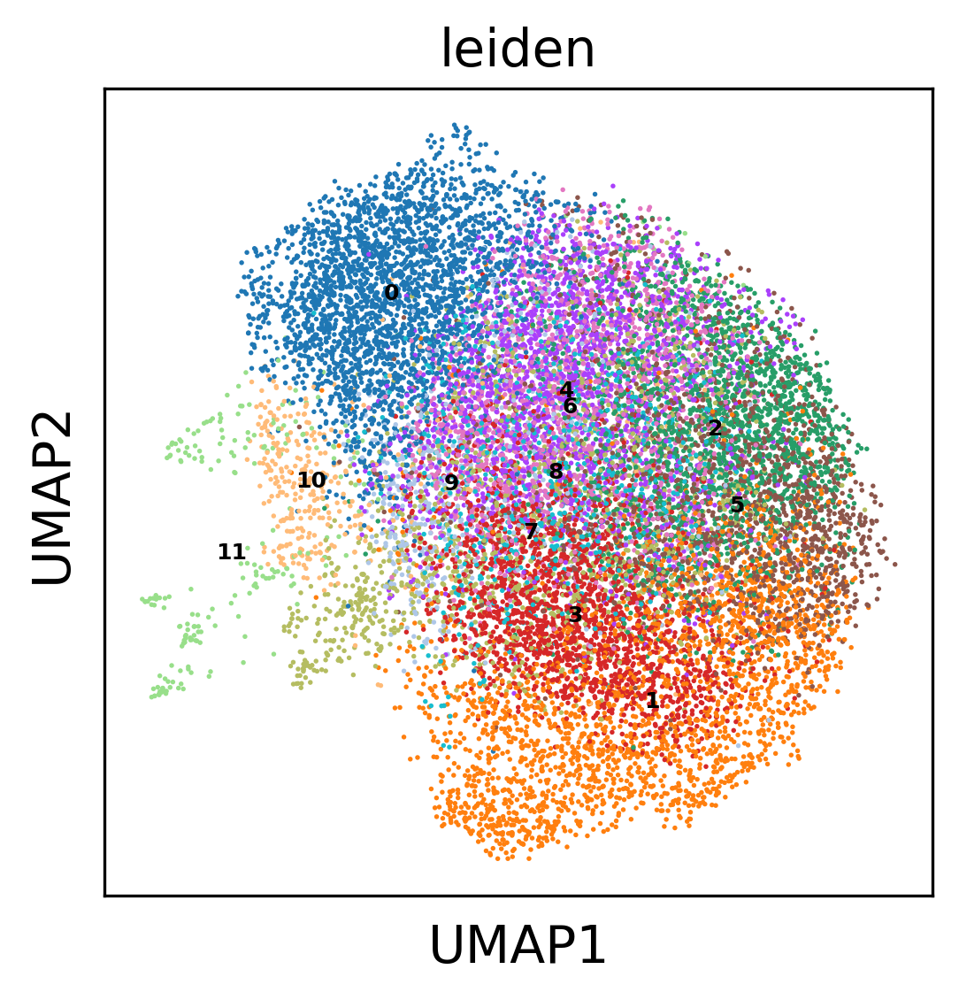

In [8]:
sc.pl.umap(adata, color = ['leiden',],legend_loc='on data',legend_fontsize=6 )

/home/LiuTL/anaconda3/envs/scanpy/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


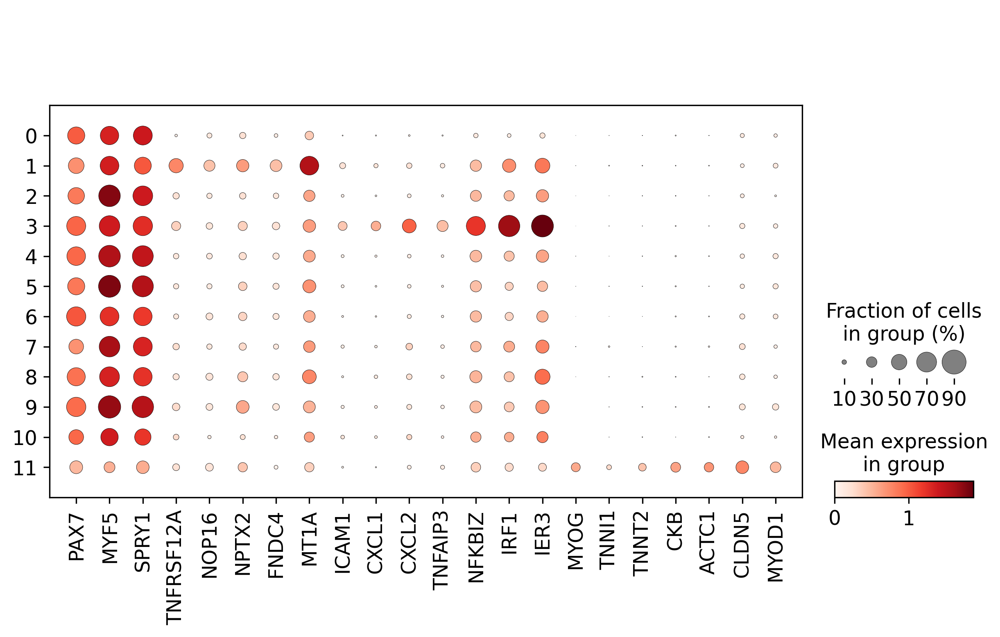

In [20]:
sc.pl.dotplot(adata,['PAX7', 'MYF5', 'SPRY1', 'TNFRSF12A', 'NOP16', 'NPTX2', 'FNDC4', 'MT1A', 'ICAM1', 'CXCL1', 'CXCL2', 
             'TNFAIP3', 'NFKBIZ', 'IRF1', 'IER3', 'MYOG', 'TNNI1', 'TNNT2', 'CKB', 'ACTC1', 'CLDN5', 'MYOD1'],groupby='leiden')

In [9]:
ribosome_biogenesis_gene = ['AATF','ABCE1','ABT1','BMS1','BOP1','BRIX1','BYSL','C1D','C1QBP','CHD7','CUL4A','CUL4B','DCAF13','DDX10','DDX17','DDX18','DDX21','DDX27','DDX28','DDX31','DDX3X','DDX47','DDX49','DDX51','DDX52','DDX54','DDX56','DHX29','DHX30','DHX37','DIMT1','DIS3','DKC1','DROSHA','EBNA1BP2','EIF2A','EIF4A3','EIF6','EMG1','ERAL1','ERCC2','ERI1','ERI2','ERI3','ESF1','EXOSC1','EXOSC10','EXOSC2','EXOSC3','EXOSC4','EXOSC5','EXOSC6','EXOSC7','EXOSC8','EXOSC9','FASTKD2','FBL','FBLL1','FCF1','FDXACB1','FRG1','FTSJ3','GAR1','GEMIN4','GLUL','GNL2','GNL3L','GPATCH4','GTF2H5','GTF3A','GTPBP10','GTPBP4','HEATR1','HEATR3','HELB','HELQ','IMP3','IMP4','ISG20','ISG20L2','KAT2B','KRI1','KRR1','LAS1L','LSG1','LSM6','LTV1','LYAR','MAK16','MALSU1','MDN1','METTL15','METTL16','METTL17','METTL18','METTL5','MPHOSPH10','MPHOSPH6','MPV17L2','MRM1','MRPL1','MRPL20','MRPL22','MRPL36','MRPS11','MRPS2','MRPS7','MRTO4','MTERF3','MTERF4','MTG2','MYBBP1A','NAF1','NAT10','NGDN','NGRN','NHP2','NIFK','NIP7','NLE1','NMD3','NOB1','NOC2L','NOC4L','NOL10','NOL11','NOL6','NOL8','NOL9','NOLC1','NOM1','NOP10','NOP14','NOP16','NOP2','NOP56','NOP58','NOP9','NPM1','NPM3','NSA2','NSUN3','NSUN4','NSUN5','NUDT16','NUP88','NVL','PA2G4','PAK1IP1','PDCD11','PES1','PIH1D1','PIH1D2','PIN4','PINX1','POP4','POP5','POP7','PPAN','PRKDC','PTEN','PWP1','PWP2','RAN','RBFA','RCL1','REXO4','RIOK1','RIOK2','RIOK3','RMRP','RNASEL','RPF1','RPF2','RPL10','RPL10A','RPL10L','RPL11','RPL14','RPL23A','RPL24','RPL26','RPL26L1','RPL27','RPL3','RPL35','RPL35A','RPL38','RPL3L','RPL5','RPL6','RPL7','RPL7A','RPL7L1','RPLP0','RPP25','RPP30','RPP38','RPP40','RPS14','RPS15','RPS16','RPS17','RPS19','RPS21','RPS24','RPS25','RPS27','RPS27L','RPS28','RPS5','RPS6','RPS7','RPS8','RPSA','RPUSD1','RPUSD2','RPUSD3','RPUSD4','RRN3','RRP1','RRP12','RRP15','RRP1B','RRP36','RRP7A','RRP8','RRP9','RRS1','RSL1D1','RSL24D1','SART1','SBDS','SDAD1','SHQ1','SIRT7','SNU13','SRFBP1','SURF6','SUV39H1','TBL3','TFB1M','TFB2M','TRAF7','TRMT112','TRMT61B','TSC1','TSR1','TSR2','TSR3','URB1','URB2','USP36','UTP14A','UTP14C','UTP15','UTP18','UTP20','UTP23','UTP3','UTP4','UTP6','VCX','WBP11','WDR12','WDR18','WDR3','WDR36','WDR43','WDR46','WDR55','WDR74','WDR75','XPO1','XRCC5','XRN2','YBEY','YTHDF2','ZCCHC4','ZNF622','ZNF658','ZNHIT3','ZNHIT6',]
sc.tl.score_genes(adata,ribosome_biogenesis_gene)

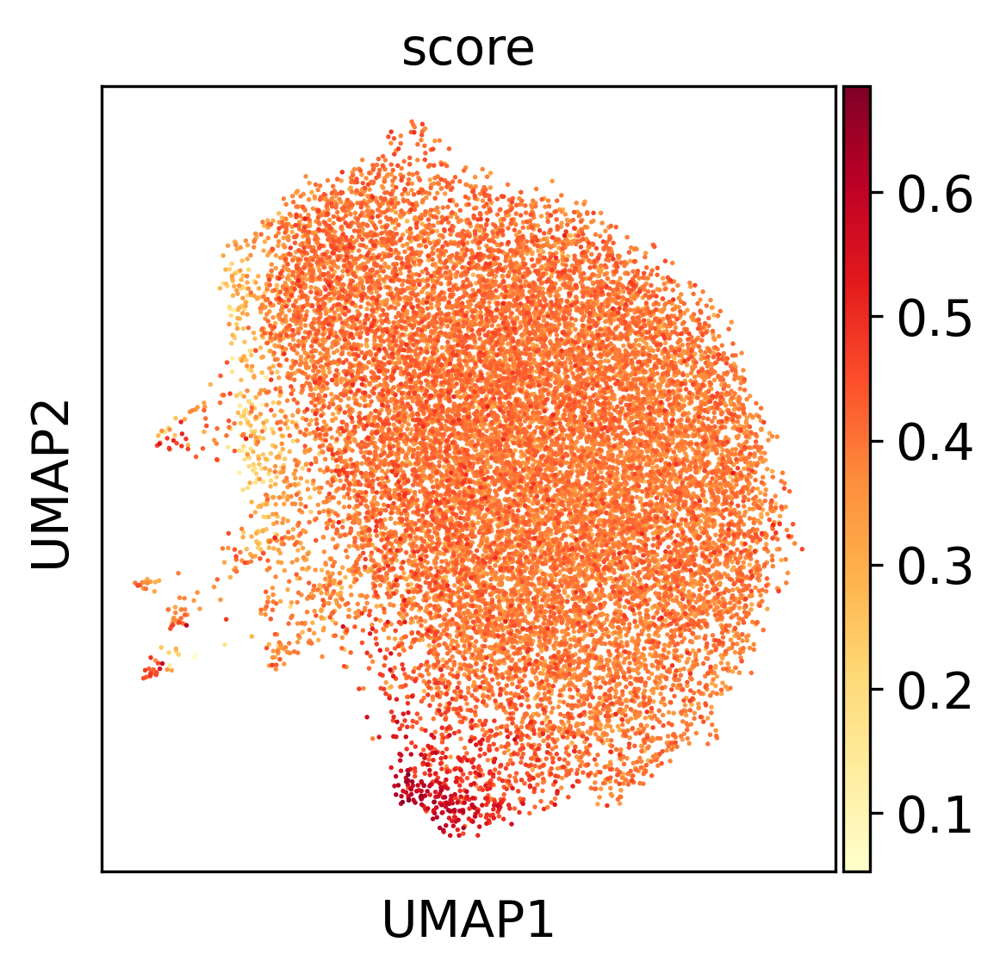

In [10]:
sc.pl.umap(adata,color=['score'],color_map='YlOrRd')

***
Moli 文件

In [43]:
# 原始数据
adata_sc = sc.read(f'{results}/ICM_scell_dbrm_scvi_v2_2023-03-06.h5ad')

In [51]:
# 
adata_diet = sc.AnnData(X = adata_sc[adata.obs.index].X, obs = adata.obs, var = adata.raw.var, obsm = adata.obsm, obsp=adata.obsp)
adata_diet

AnnData object with n_obs × n_vars = 17554 × 33538
    obs: 'SampleID', 'barcode', 'concat_sample_no', 'DonorID', 'Sex', 'Age', 'Species', 'Operator', 'Sample', '10X_version', 'n_counts', 'n_counts_raw', 'percent_soup', 'n_counts_spliced', 'n_counts_unspliced', 'percent_spliced', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'Age_group', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'S_score', 'G2M_score', 'phase', 'is_doublet_scrub', 'annotation_level0', 'annotation_level1', 'annotation_level2', 'sample_type', 'update_status', 'putative_doublet_scvi1', '_scvi_batch', '_scvi_labels', 'leiden', 'coarse_predicted_labels', 'coarse_over_clustering', 'coarse_majority_voting', 'coarse_conf_score', 'fine_predicted_labels', 'fine_over_clustering', 'fine_majority_voting', 'fine_conf_score', 'fine2_predicted_labels', 'fine2_over_clustering', 'fine2_majority_voting', 'fine2_conf_score'
    var: 'ENSEMBL', 'SYMBOL', 'n_counts', 'n_cells', 'mean', 'std'
    obsm: '

In [52]:
del adata_diet.obsm[ '_scvi_extra_categoricals']
del adata_diet.obsm['_scvi_extra_continuous']
del adata_diet.obsp

In [53]:
Age_bin = []
for i in list(adata_diet.obs['Age_group']):
    if i == 'young':
        Age_bin.append('1Young')
    elif i == 'old':
        Age_bin.append('2Aged')
    else: print(i)

adata_diet.obs['Age_bin'] = Age_bin

In [54]:
adata_diet.write_loom('/public/LiuTL/Rstudio/skeletal_muscle/moli_v2/data/human_SKM_v2.0_MuSC_scVI-analysis_adata_diet.loom',write_obsm_varm=True)
adata_diet.obs.to_csv('/public/LiuTL/Rstudio/skeletal_muscle/moli_v2/data/human_SKM_v2.0_MuSC_scVI-analysis_adata_diet_obs.csv')
adata_diet.var.to_csv('/public/LiuTL/Rstudio/skeletal_muscle/moli_v2/data/human_SKM_v2.0_MuSC_scVI-analysis_adata_diet_var.csv')